### Make Predictions on new images

In [46]:
from keras.models import model_from_json
import cv2
import dlib
from skimage.transform import resize
import numpy as np
from matplotlib import image
import matplotlib.pyplot as plt
import pandas as pd

In [47]:
### HERE comes the image collection code

In [48]:
## Test on Valid dataset

In [49]:
dataset_val=pd.read_csv('../data/valid.csv')
dataset_val.head()

,nameid,name,book_date,city,holding_location,age,height,weight,race,sex,eyes,hair,bookid,feet,inches,bmi,gender,index
0,7482,JAMES DEYO ROBINSON,3/10/2017 10:05:55 AM,"WAUKEE, IA",PCJ,54,1.8034,127.00576,Black,Male,Brown,Black,248038,5.0,11.0,39.051641,1,248038.jpg
1,754952,CORDERRO ALTON LAURENCE,4/23/2017 8:57:43 AM,"DES MOINES, IA",Cherokee Mental Health,26,1.8034,95.25432,Black,Male,Brown,Black,250464,5.0,11.0,29.288731,1,250464.jpg
2,644421,TAYLOR LOUIS HARLAN,12/7/2017 4:00:07 PM,"DES MOINES, IA",PCJ,24,1.7526,131.54168,White,Male,Green,Blonde,263711,5.0,9.0,42.825039,1,263711.jpg
3,75759,WILLIAM EDGAR BURTON,9/20/2018 3:14:37 PM,"INDIANOLA, IA",PCJ,47,1.7018,127.00576,White,Male,Blue,Brown,280669,5.0,7.0,43.853714,1,280669.jpg
4,111677,JOSHUA LEE ADAMS,12/28/2018 10:51:54 PM,"DES MOINES, IA",PCJ,30,1.9050,124.73780,White,Male,Blue,Blonde,285997,6.0,3.0,34.372263,1,285997.jpg


In [50]:
dataset_val.shape

(282, 18)

In [51]:
dataset_val=dataset_val[dataset_val['bmi']<=40]

In [52]:
all_paths_val=dataset_val['index'].tolist()
all_bmi_val=dataset_val['bmi']

In [53]:
def preprocess_image(img=None,data=None,image_path=None):
    if image_path:
        image_path='../data/face/'+str(path)
        img = cv2.imread(image_path)
        data= image.imread(image_path)
    
    gray = cv2.cvtColor(src=img, code=cv2.COLOR_BGR2GRAY)
    detector = dlib.get_frontal_face_detector()
    faces = detector(gray)
    if len(faces)>0:
        x1 = faces[0].left() # left point
        y1 = faces[0].top() # top point
        x2 = faces[0].right() # right point
        y2 = faces[0].bottom()
        face_out=cv2.rectangle(img=img, pt1=(x1, y1), pt2=(x2, y2), color=(0, 255, 0))

        ## Add some margin on the faces
        margin20_x=int(((x2-x1)*0.2)//2)
        margin20_y=int(((y2-y1)*0.2)//2)

        margin10_x=int(((x2-x1)*0.1)//2)
        margin10_y=int(((y2-y1)*0.1)//2)

        output= data[y1-margin20_y:y2+margin20_y,x1-margin20_x:x2+margin20_x,:]

        #resized_data = resize(output, (300, 300, 3))

        resized_data = cv2.resize(output, (300, 300), interpolation = cv2.INTER_AREA)
    else:
        resized_data=None
        
    return resized_data

In [54]:
# model_without_tl_without_aug
# model_without_tl_with_aug
# model_with_tl_without_aug
# model_with_tl_with_aug

model_name1='model_without_tl_without_aug'
json_file = open(model_name1+'.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model1 = model_from_json(loaded_model_json)
# load weights into new model
loaded_model1.load_weights(model_name1+".h5")



model_name2='model_without_tl_with_aug'
json_file = open(model_name2+'.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model2 = model_from_json(loaded_model_json)
# load weights into new model
loaded_model2.load_weights(model_name2+".h5")



model_name3='model_with_tl_without_aug'
json_file = open(model_name3+'.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model3 = model_from_json(loaded_model_json)
# load weights into new model
loaded_model3.load_weights(model_name3+".h5")


model_name4='model_with_tl_with_aug'
json_file = open(model_name4+'.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model4 = model_from_json(loaded_model_json)
# load weights into new model
loaded_model4.load_weights(model_name4+".h5")

print("Loaded models from disk")


Loaded models from disk


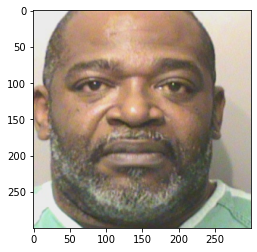

True BMI 39.05164088844344
Predicted BMI 1:  23.818691
Predicted BMI 2:  25.914377
Predicted BMI 3:  31.839344
Predicted BMI 4:  28.870173
Difference:  15.232949634781328
*************************************************************************



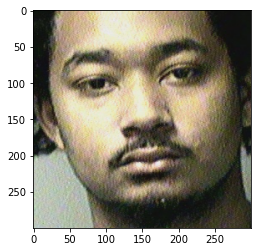

True BMI 29.28873066633258
Predicted BMI 1:  36.275425
Predicted BMI 2:  28.726753
Predicted BMI 3:  29.46626
Predicted BMI 4:  23.71001
Difference:  6.986694290942811
*************************************************************************



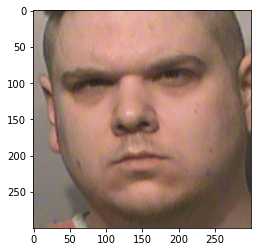

True BMI 34.37226252230282
Predicted BMI 1:  32.623222
Predicted BMI 2:  22.213861
Predicted BMI 3:  34.543015
Predicted BMI 4:  27.18939
Difference:  1.7490401712286001
*************************************************************************



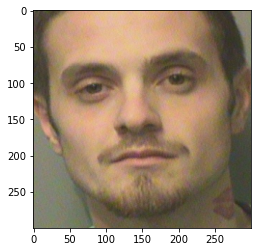

True BMI 18.652851183253382
Predicted BMI 1:  25.636732
Predicted BMI 2:  21.758997
Predicted BMI 3:  25.729769
Predicted BMI 4:  21.574736
Difference:  6.983880918187047
*************************************************************************



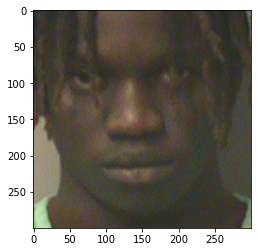

True BMI 20.223171174372496
Predicted BMI 1:  15.562933
Predicted BMI 2:  20.403189
Predicted BMI 3:  21.053263
Predicted BMI 4:  20.448885
Difference:  4.660238206232847
*************************************************************************



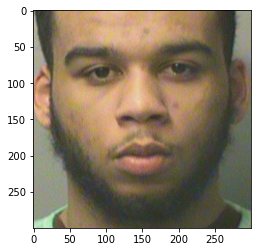

True BMI 23.08821093528845
Predicted BMI 1:  25.099512
Predicted BMI 2:  23.309671
Predicted BMI 3:  27.895634
Predicted BMI 4:  21.680748
Difference:  2.0113011649312753
*************************************************************************



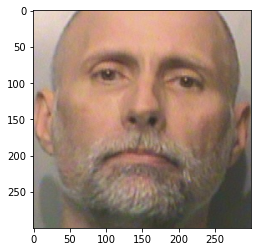

True BMI 22.93529996910766
Predicted BMI 1:  24.227837
Predicted BMI 2:  23.514982
Predicted BMI 3:  25.977663
Predicted BMI 4:  24.659151
Difference:  1.2925366397790583
*************************************************************************



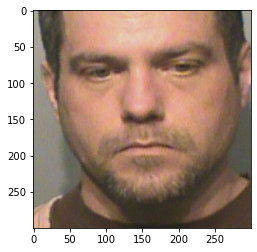

True BMI 28.24542609599452
Predicted BMI 1:  27.017738
Predicted BMI 2:  21.338083
Predicted BMI 3:  31.410185
Predicted BMI 4:  26.782682
Difference:  1.2276877537093647
*************************************************************************



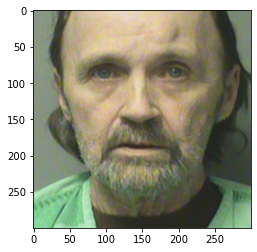

True BMI 25.067200444027456
Predicted BMI 1:  25.896067
Predicted BMI 2:  27.413206
Predicted BMI 3:  25.750002
Predicted BMI 4:  23.031769
Difference:  0.8288662216219578
*************************************************************************



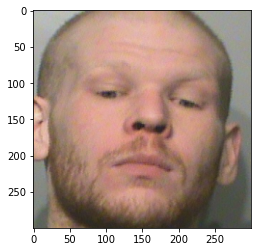

True BMI 23.74810865177286
Predicted BMI 1:  28.884012
Predicted BMI 2:  22.321577
Predicted BMI 3:  31.190117
Predicted BMI 4:  29.662128
Difference:  5.135903570517179
*************************************************************************



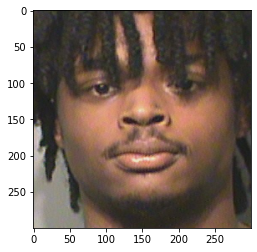

True BMI 25.990728881438997
Predicted BMI 1:  27.734854
Predicted BMI 2:  23.871717
Predicted BMI 3:  28.778263
Predicted BMI 4:  25.49502
Difference:  1.7441248630678388
*************************************************************************



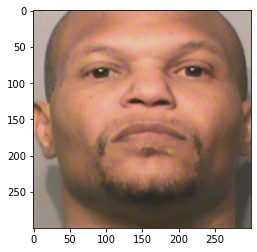

True BMI 32.1071833945851
Predicted BMI 1:  23.6136
Predicted BMI 2:  21.113607
Predicted BMI 3:  28.175055
Predicted BMI 4:  25.089607
Difference:  8.49358361736342
*************************************************************************



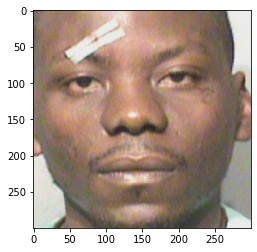

True BMI 25.109607362071863
Predicted BMI 1:  23.392025
Predicted BMI 2:  22.871092
Predicted BMI 3:  28.676445
Predicted BMI 4:  23.047684
Difference:  1.7175823681753783
*************************************************************************



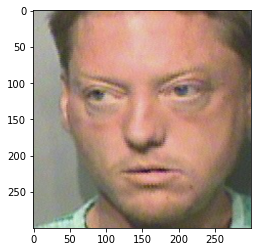

True BMI 27.463633052266108
Predicted BMI 1:  26.661495
Predicted BMI 2:  26.270891
Predicted BMI 3:  29.561157
Predicted BMI 4:  24.217236
Difference:  0.8021378435258733
*************************************************************************



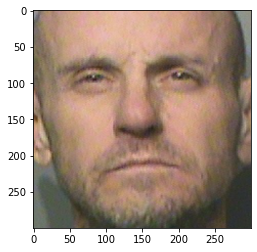

True BMI 27.457132784088053
Predicted BMI 1:  24.061993
Predicted BMI 2:  22.918324
Predicted BMI 3:  28.044981
Predicted BMI 4:  23.63151
Difference:  3.395140138824381
*************************************************************************



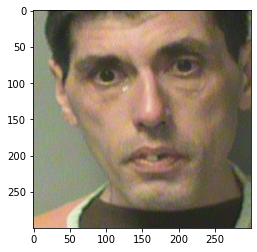

True BMI 24.40727555527716
Predicted BMI 1:  29.758116
Predicted BMI 2:  21.218283
Predicted BMI 3:  22.309677
Predicted BMI 4:  19.73484
Difference:  5.3508402131554575
*************************************************************************



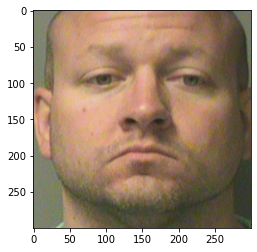

True BMI 26.58105883319517
Predicted BMI 1:  30.250843
Predicted BMI 2:  23.807674
Predicted BMI 3:  31.79317
Predicted BMI 4:  29.186033
Difference:  3.6697842149005346
*************************************************************************



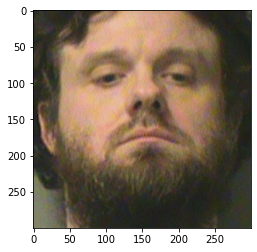

True BMI 34.66556458313792
Predicted BMI 1:  30.649399
Predicted BMI 2:  22.936478
Predicted BMI 3:  29.563549
Predicted BMI 4:  31.161455
Difference:  4.016165779426984
*************************************************************************



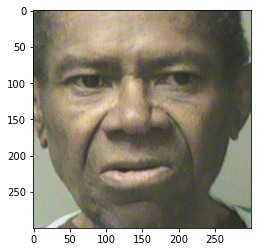

True BMI 20.223171174372496
Predicted BMI 1:  19.24262
Predicted BMI 2:  20.433558
Predicted BMI 3:  28.416342
Predicted BMI 4:  20.762295
Difference:  0.9805507062328473
*************************************************************************



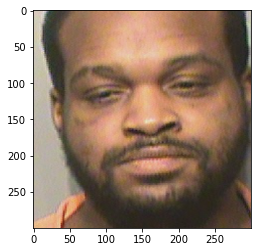

True BMI 32.48796079612743
Predicted BMI 1:  29.54675
Predicted BMI 2:  18.808182
Predicted BMI 3:  31.110415
Predicted BMI 4:  25.445938
Difference:  2.9412116811371973
*************************************************************************



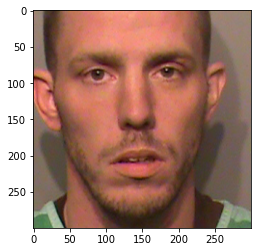

True BMI 28.05778432392824
Predicted BMI 1:  22.80242
Predicted BMI 2:  27.927994
Predicted BMI 3:  19.503399
Predicted BMI 4:  20.45293
Difference:  5.255364661452653
*************************************************************************



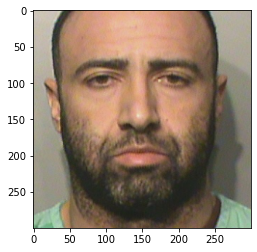

True BMI 27.124575854089983
Predicted BMI 1:  25.13552
Predicted BMI 2:  20.384933
Predicted BMI 3:  30.371923
Predicted BMI 4:  23.890665
Difference:  1.989054919031389
*************************************************************************



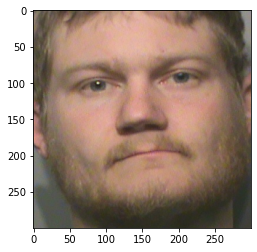

True BMI 26.544442068475973
Predicted BMI 1:  29.05421
Predicted BMI 2:  23.49579
Predicted BMI 3:  30.231663
Predicted BMI 4:  23.673038
Difference:  2.5097685943658234
*************************************************************************



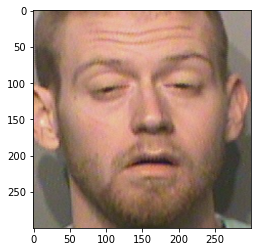

True BMI 21.28669136231006
Predicted BMI 1:  23.969095
Predicted BMI 2:  22.91696
Predicted BMI 3:  27.66243
Predicted BMI 4:  25.597033
Difference:  2.6824038677924804
*************************************************************************



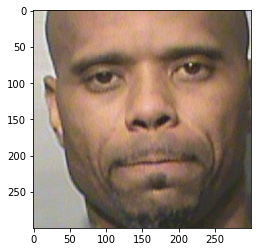

True BMI 24.845469480551056
Predicted BMI 1:  28.54779
Predicted BMI 2:  21.196032
Predicted BMI 3:  29.666384
Predicted BMI 4:  21.99938
Difference:  3.7023210467926937
*************************************************************************



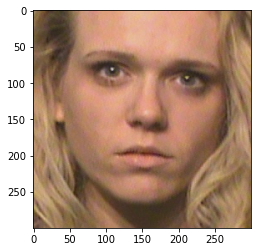

True BMI 19.766213407859343
Predicted BMI 1:  19.638084
Predicted BMI 2:  20.749094
Predicted BMI 3:  27.352463
Predicted BMI 4:  21.023657
Difference:  0.12812899623824947
*************************************************************************



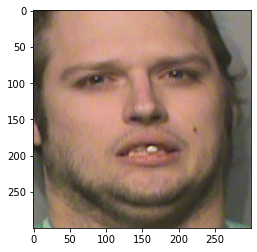

True BMI 23.70992482512638
Predicted BMI 1:  27.864119
Predicted BMI 2:  22.412361
Predicted BMI 3:  28.731651
Predicted BMI 4:  27.328556
Difference:  4.154193750923426
*************************************************************************



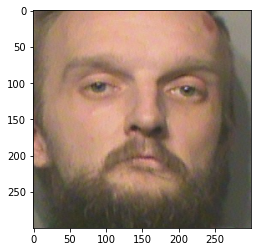

True BMI 23.49306102042812
Predicted BMI 1:  26.174332
Predicted BMI 2:  23.629389
Predicted BMI 3:  27.79886
Predicted BMI 4:  24.384956
Difference:  2.6812706446109438
*************************************************************************



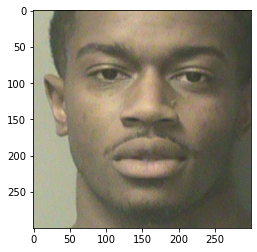

True BMI 21.5225205960616
Predicted BMI 1:  19.711336
Predicted BMI 2:  21.823593
Predicted BMI 3:  25.919405
Predicted BMI 4:  20.10259
Difference:  1.8111844601973424
*************************************************************************



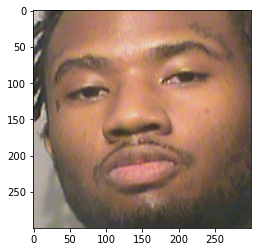

True BMI 29.28873066633258
Predicted BMI 1:  24.199543
Predicted BMI 2:  23.614864
Predicted BMI 3:  26.435053
Predicted BMI 4:  22.655481
Difference:  5.089187667065001
*************************************************************************



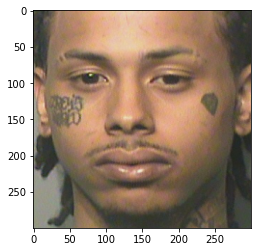

True BMI 20.175304354281803
Predicted BMI 1:  25.988678
Predicted BMI 2:  20.236544
Predicted BMI 3:  24.641823
Predicted BMI 4:  19.893307
Difference:  5.813373624233822
*************************************************************************



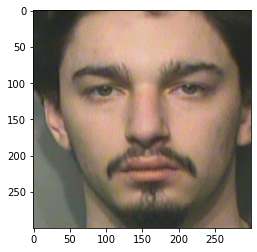

True BMI 20.982316528453072
Predicted BMI 1:  23.60035
Predicted BMI 2:  21.159622
Predicted BMI 3:  22.730835
Predicted BMI 4:  21.067017
Difference:  2.618032897816459
*************************************************************************



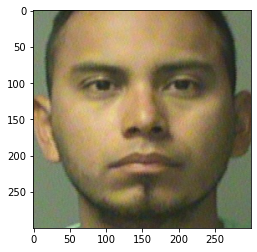

True BMI 23.49306102042812
Predicted BMI 1:  24.62117
Predicted BMI 2:  22.734798
Predicted BMI 3:  29.06113
Predicted BMI 4:  21.925083
Difference:  1.1281090235171938
*************************************************************************



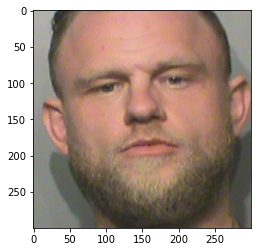

True BMI 25.067200444027456
Predicted BMI 1:  30.914494
Predicted BMI 2:  22.39762
Predicted BMI 3:  31.806995
Predicted BMI 4:  24.382414
Difference:  5.847293116763559
*************************************************************************



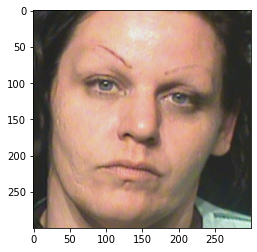

True BMI 37.92957218604979
Predicted BMI 1:  29.206842
Predicted BMI 2:  23.59473
Predicted BMI 3:  30.238642
Predicted BMI 4:  26.88233
Difference:  8.722729763564438
*************************************************************************



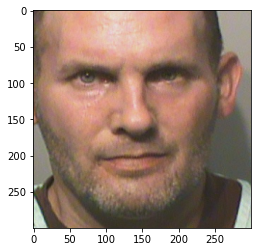

True BMI 28.48080464679448
Predicted BMI 1:  24.732794
Predicted BMI 2:  22.182037
Predicted BMI 3:  30.495642
Predicted BMI 4:  27.808132
Difference:  3.74801083881108
*************************************************************************



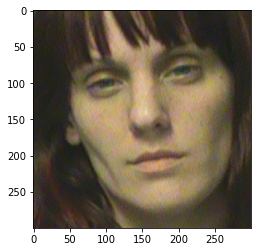

True BMI 25.68531264550561
Predicted BMI 1:  21.424498
Predicted BMI 2:  20.77685
Predicted BMI 3:  20.107468
Predicted BMI 4:  21.31375
Difference:  4.260815041135494
*************************************************************************



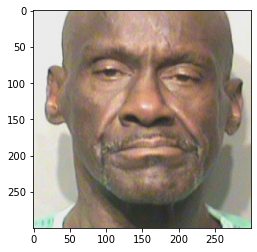

True BMI 25.10462628542793
Predicted BMI 1:  22.649954
Predicted BMI 2:  24.402073
Predicted BMI 3:  22.893852
Predicted BMI 4:  20.465033
Difference:  2.454672443264844
*************************************************************************



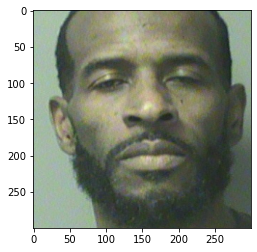

True BMI 21.91004520513196
Predicted BMI 1:  23.227802
Predicted BMI 2:  24.06154
Predicted BMI 3:  27.862677
Predicted BMI 4:  23.92121
Difference:  1.3177570714793667
*************************************************************************



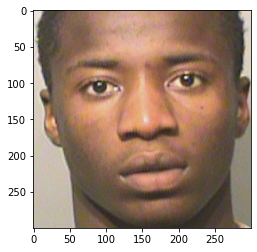

True BMI 23.62760785172904
Predicted BMI 1:  25.592844
Predicted BMI 2:  20.774672
Predicted BMI 3:  22.14141
Predicted BMI 4:  20.958895
Difference:  1.9652361576703754
*************************************************************************



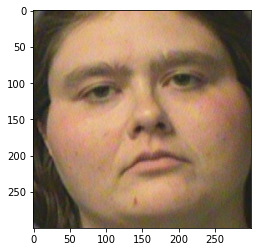

True BMI 38.9392064937976
Predicted BMI 1:  24.35298
Predicted BMI 2:  23.438187
Predicted BMI 3:  34.938526
Predicted BMI 4:  30.478182
Difference:  14.586226833763419
*************************************************************************



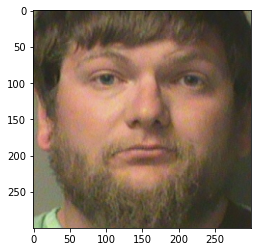

True BMI 31.566363540890343
Predicted BMI 1:  31.047256
Predicted BMI 2:  22.092028
Predicted BMI 3:  28.65224
Predicted BMI 4:  28.590315
Difference:  0.5191070711637806
*************************************************************************



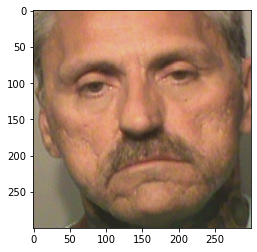

True BMI 28.696694128082136
Predicted BMI 1:  20.613323
Predicted BMI 2:  18.583132
Predicted BMI 3:  24.82912
Predicted BMI 4:  23.39977
Difference:  8.083370916412214
*************************************************************************



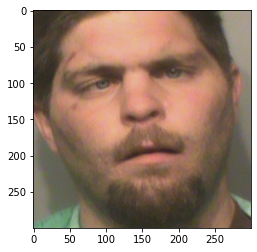

True BMI 24.365970597095576
Predicted BMI 1:  20.810457
Predicted BMI 2:  21.648487
Predicted BMI 3:  32.008053
Predicted BMI 4:  27.165663
Difference:  3.5555133674813177
*************************************************************************



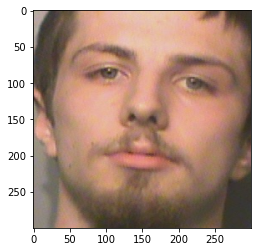

True BMI 20.805103242859545
Predicted BMI 1:  21.679756
Predicted BMI 2:  22.43802
Predicted BMI 3:  26.915129
Predicted BMI 4:  20.916306
Difference:  0.8746529216912364
*************************************************************************



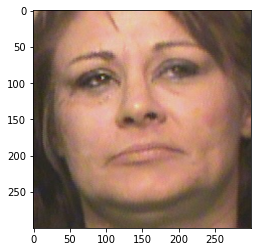

True BMI 21.72881905559565
Predicted BMI 1:  24.76368
Predicted BMI 2:  24.67589
Predicted BMI 3:  28.591623
Predicted BMI 4:  27.969461
Difference:  3.034860448798881
*************************************************************************



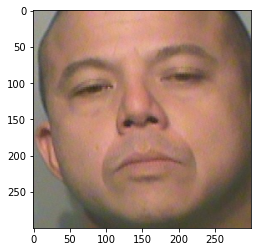

True BMI 32.28048696685088
Predicted BMI 1:  20.45581
Predicted BMI 2:  26.038761
Predicted BMI 3:  29.36139
Predicted BMI 4:  33.17195
Difference:  11.82467641997588
*************************************************************************



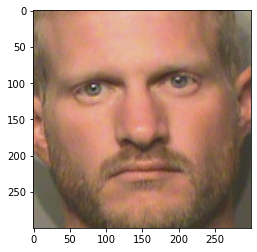

True BMI 21.5225205960616
Predicted BMI 1:  20.263298
Predicted BMI 2:  21.62937
Predicted BMI 3:  27.382378
Predicted BMI 4:  23.518957
Difference:  1.2592225613936314
*************************************************************************



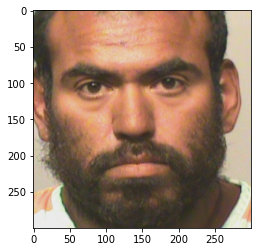

True BMI 27.124575854089983
Predicted BMI 1:  20.896791
Predicted BMI 2:  21.577421
Predicted BMI 3:  26.689167
Predicted BMI 4:  26.175491
Difference:  6.2277843959601
*************************************************************************



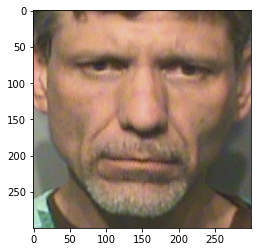

True BMI 24.40727555527716
Predicted BMI 1:  23.875498
Predicted BMI 2:  23.09894
Predicted BMI 3:  28.017757
Predicted BMI 4:  23.143942
Difference:  0.5317777372839956
*************************************************************************



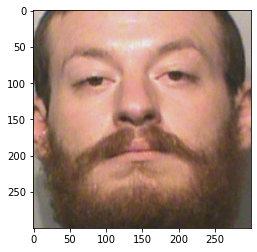

True BMI 28.365516291925804
Predicted BMI 1:  21.884743
Predicted BMI 2:  23.364485
Predicted BMI 3:  30.755081
Predicted BMI 4:  26.641222
Difference:  6.480773555109398
*************************************************************************



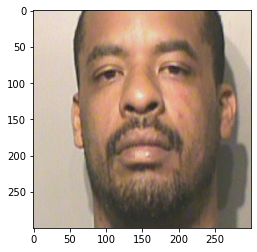

True BMI 25.768347061385484
Predicted BMI 1:  26.636274
Predicted BMI 2:  20.99274
Predicted BMI 3:  26.461271
Predicted BMI 4:  24.013973
Difference:  0.867927276383071
*************************************************************************



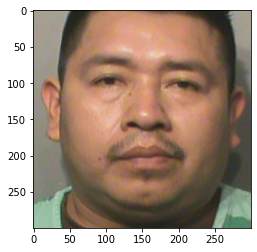

True BMI 30.666462618508334
Predicted BMI 1:  26.399426
Predicted BMI 2:  26.172218
Predicted BMI 3:  34.150658
Predicted BMI 4:  28.394314
Difference:  4.267037111916537
*************************************************************************



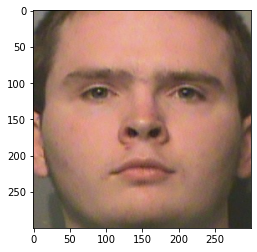

True BMI 29.75787729254229
Predicted BMI 1:  23.026804
Predicted BMI 2:  24.151339
Predicted BMI 3:  29.926281
Predicted BMI 4:  25.824837
Difference:  6.731073322205376
*************************************************************************



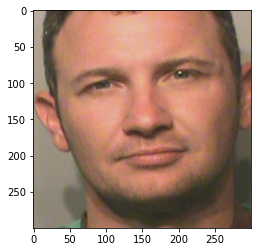

True BMI 27.09533037689377
Predicted BMI 1:  25.183205
Predicted BMI 2:  20.334404
Predicted BMI 3:  29.925522
Predicted BMI 4:  23.314018
Difference:  1.9121257260148639
*************************************************************************



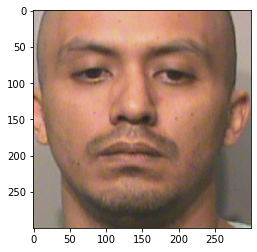

True BMI 22.80716931676077
Predicted BMI 1:  23.142977
Predicted BMI 2:  22.056208
Predicted BMI 3:  26.478523
Predicted BMI 4:  22.674803
Difference:  0.3358074441034873
*************************************************************************



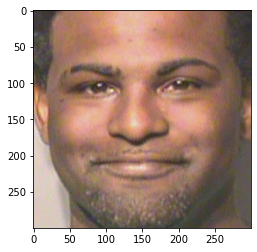

True BMI 28.209558888253586
Predicted BMI 1:  23.695877
Predicted BMI 2:  20.94349
Predicted BMI 3:  27.21657
Predicted BMI 4:  24.334417
Difference:  4.513681813058273
*************************************************************************



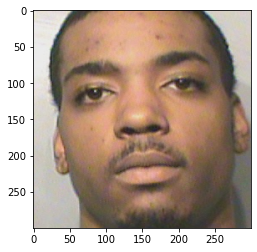

True BMI 21.1845116896954
Predicted BMI 1:  29.281382
Predicted BMI 2:  23.32656
Predicted BMI 3:  25.790106
Predicted BMI 4:  21.50707
Difference:  8.096869917360262
*************************************************************************



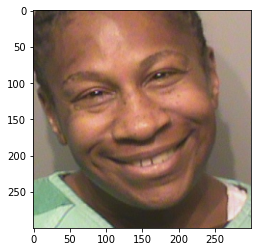

True BMI 23.226927809787817
Predicted BMI 1:  19.289127
Predicted BMI 2:  22.527317
Predicted BMI 3:  31.144926
Predicted BMI 4:  23.91788
Difference:  3.9378004599343015
*************************************************************************



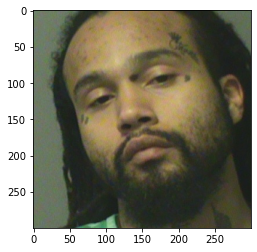

True BMI 27.261859421678025
Predicted BMI 1:  25.600615
Predicted BMI 2:  25.600258
Predicted BMI 3:  30.550432
Predicted BMI 4:  22.973862
Difference:  1.661244873948533
*************************************************************************



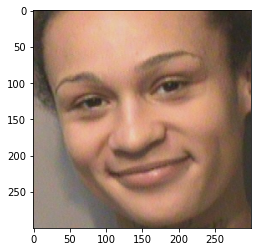

True BMI 24.030678920732843
Predicted BMI 1:  23.744766
Predicted BMI 2:  21.120996
Predicted BMI 3:  29.352379
Predicted BMI 4:  21.714205
Difference:  0.28591268538128034
*************************************************************************



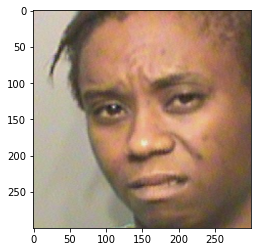

True BMI 29.2597089355891
Predicted BMI 1:  23.190144
Predicted BMI 2:  22.20182
Predicted BMI 3:  27.391039
Predicted BMI 4:  21.751125
Difference:  6.069565350384021
*************************************************************************



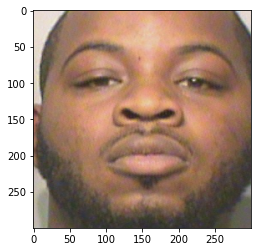

True BMI 28.24542609599452
Predicted BMI 1:  21.80172
Predicted BMI 2:  21.705372
Predicted BMI 3:  32.702393
Predicted BMI 4:  27.153913
Difference:  6.443706430467177
*************************************************************************



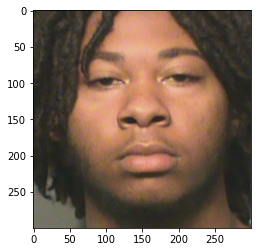

True BMI 27.36860318011293
Predicted BMI 1:  28.478613
Predicted BMI 2:  22.954174
Predicted BMI 3:  29.257498
Predicted BMI 4:  22.823734
Difference:  1.1100097196673424
*************************************************************************



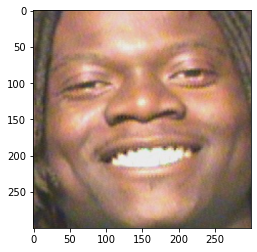

True BMI 25.10462628542793
Predicted BMI 1:  12.835719
Predicted BMI 2:  25.577576
Predicted BMI 3:  25.490162
Predicted BMI 4:  31.608
Difference:  12.268907176846387
*************************************************************************



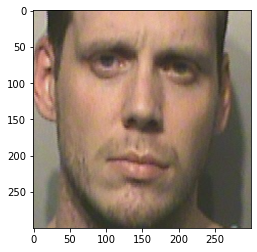

True BMI 28.89008079133844
Predicted BMI 1:  21.673092
Predicted BMI 2:  20.66939
Predicted BMI 3:  26.480616
Predicted BMI 4:  23.089052
Difference:  7.216988902910707
*************************************************************************



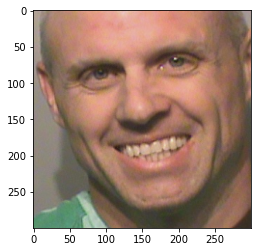

True BMI 27.124575854089983
Predicted BMI 1:  21.632898
Predicted BMI 2:  22.826466
Predicted BMI 3:  29.004595
Predicted BMI 4:  22.501335
Difference:  5.491677523401506
*************************************************************************



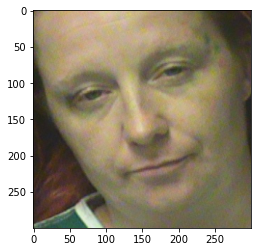

True BMI 31.09306218612437
Predicted BMI 1:  22.923832
Predicted BMI 2:  21.424704
Predicted BMI 3:  29.719847
Predicted BMI 4:  22.864998
Difference:  8.169230246427105
*************************************************************************



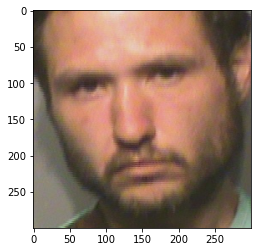

True BMI 23.62760785172904
Predicted BMI 1:  26.01998
Predicted BMI 2:  18.06547
Predicted BMI 3:  23.75905
Predicted BMI 4:  29.568718
Difference:  2.3923716251996723
*************************************************************************



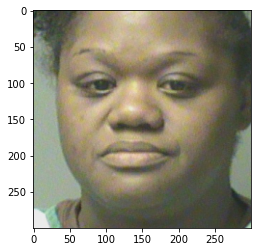

True BMI 32.80988695310724
Predicted BMI 1:  27.525097
Predicted BMI 2:  21.94358
Predicted BMI 3:  34.168495
Predicted BMI 4:  32.24601
Difference:  5.284790059796691
*************************************************************************



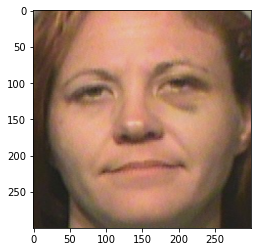

True BMI 24.96102980371641
Predicted BMI 1:  23.12154
Predicted BMI 2:  21.850134
Predicted BMI 3:  25.970165
Predicted BMI 4:  21.809477
Difference:  1.8394897341363325
*************************************************************************



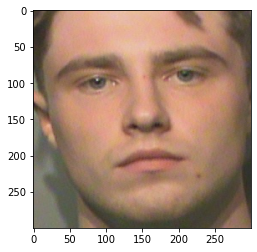

True BMI 22.23993794926365
Predicted BMI 1:  23.013165
Predicted BMI 2:  23.18271
Predicted BMI 3:  25.97517
Predicted BMI 4:  21.767868
Difference:  0.7732265710000235
*************************************************************************



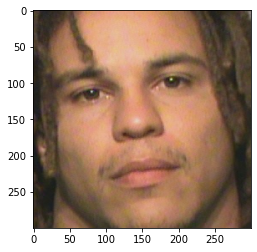

True BMI 24.276163054442392
Predicted BMI 1:  20.766459
Predicted BMI 2:  22.185946
Predicted BMI 3:  23.94012
Predicted BMI 4:  21.849314
Difference:  3.5097045430898532
*************************************************************************



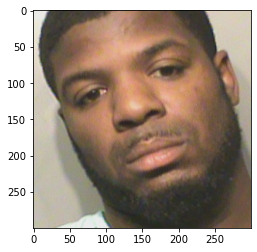

True BMI 24.39428618813409
Predicted BMI 1:  31.040459
Predicted BMI 2:  21.655653
Predicted BMI 3:  31.00452
Predicted BMI 4:  28.451166
Difference:  6.64617249106513
*************************************************************************



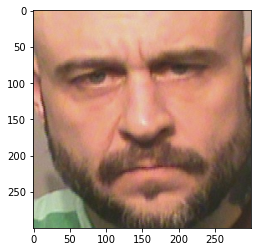

True BMI 35.731231929591885
Predicted BMI 1:  19.148796
Predicted BMI 2:  22.408304
Predicted BMI 3:  27.955753
Predicted BMI 4:  25.867811
Difference:  16.582435848048917
*************************************************************************



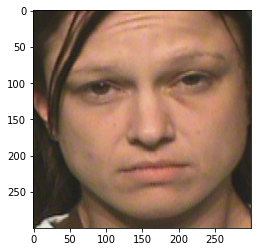

True BMI 21.948043896087796
Predicted BMI 1:  23.175022
Predicted BMI 2:  20.824057
Predicted BMI 3:  32.099907
Predicted BMI 4:  21.18833
Difference:  1.2269782291563445
*************************************************************************



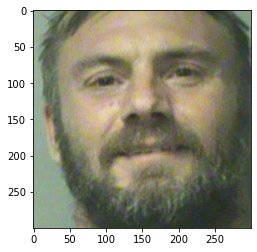

True BMI 29.52992538563601
Predicted BMI 1:  26.177814
Predicted BMI 2:  24.50913
Predicted BMI 3:  31.681795
Predicted BMI 4:  31.996704
Difference:  3.3521109019934308
*************************************************************************



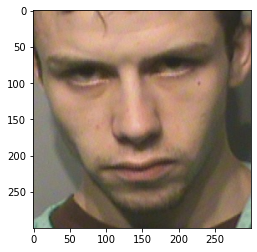

True BMI 21.10922142654944
Predicted BMI 1:  20.539959
Predicted BMI 2:  21.86356
Predicted BMI 3:  25.960707
Predicted BMI 4:  21.745092
Difference:  0.5692624726920172
*************************************************************************



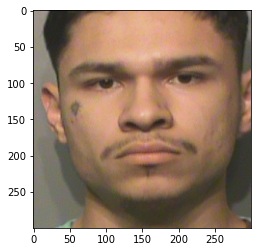

True BMI 20.63445130440557
Predicted BMI 1:  26.075418
Predicted BMI 2:  18.8651
Predicted BMI 3:  25.288551
Predicted BMI 4:  20.943747
Difference:  5.4409671678844695
*************************************************************************



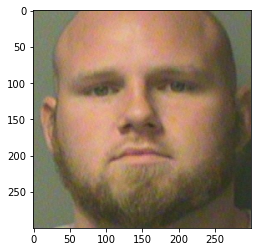

True BMI 31.566363540890343
Predicted BMI 1:  31.75882
Predicted BMI 2:  23.370443
Predicted BMI 3:  32.69144
Predicted BMI 4:  28.77398
Difference:  0.19245603918778187
*************************************************************************



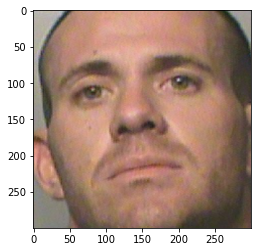

True BMI 23.747874104868117
Predicted BMI 1:  16.50413
Predicted BMI 2:  26.252747
Predicted BMI 3:  27.40831
Predicted BMI 4:  27.261082
Difference:  7.243744695078078
*************************************************************************



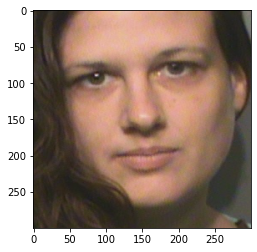

True BMI 23.85903121415618
Predicted BMI 1:  22.327293
Predicted BMI 2:  22.576946
Predicted BMI 3:  25.273027
Predicted BMI 4:  22.771265
Difference:  1.5317378181600851
*************************************************************************



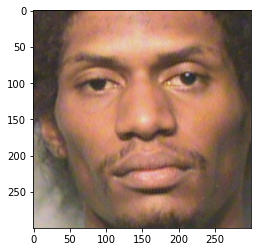

True BMI 22.23993794926365
Predicted BMI 1:  24.360605
Predicted BMI 2:  22.000261
Predicted BMI 3:  23.264246
Predicted BMI 4:  21.384604
Difference:  2.1206672906045156
*************************************************************************



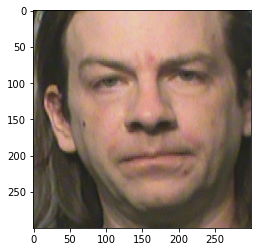

True BMI 22.428547765708775
Predicted BMI 1:  28.837172
Predicted BMI 2:  21.456106
Predicted BMI 3:  25.285488
Predicted BMI 4:  22.9342
Difference:  6.408623788856655
*************************************************************************



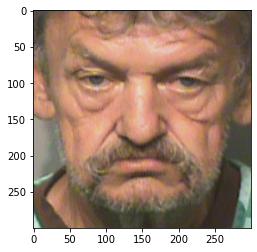

True BMI 34.45648949662791
Predicted BMI 1:  25.432758
Predicted BMI 2:  22.984602
Predicted BMI 3:  27.088135
Predicted BMI 4:  23.214914
Difference:  9.023731165329082
*************************************************************************



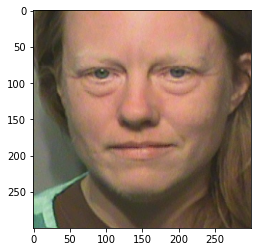

True BMI 24.21036522513816
Predicted BMI 1:  27.495794
Predicted BMI 2:  22.70112
Predicted BMI 3:  25.391184
Predicted BMI 4:  22.311337
Difference:  3.28542907112649
*************************************************************************



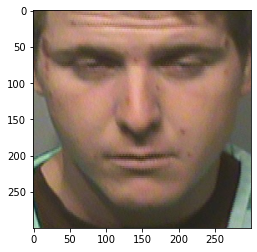

True BMI 28.2891671108786
Predicted BMI 1:  24.805578
Predicted BMI 2:  21.619192
Predicted BMI 3:  25.832819
Predicted BMI 4:  25.97609
Difference:  3.483588879067078
*************************************************************************



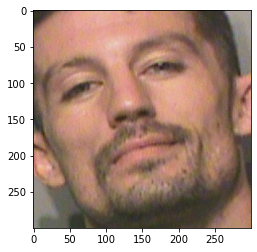

True BMI 22.69241303354065
Predicted BMI 1:  19.153818
Predicted BMI 2:  22.694199
Predicted BMI 3:  26.1019
Predicted BMI 4:  22.387423
Difference:  3.5385949030474855
*************************************************************************



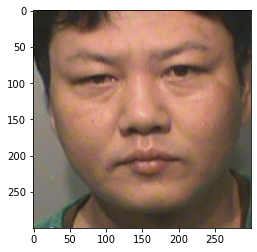

True BMI 25.059265088456662
Predicted BMI 1:  28.863342
Predicted BMI 2:  22.018564
Predicted BMI 3:  33.88279
Predicted BMI 4:  30.8073
Difference:  3.8040771966995877
*************************************************************************



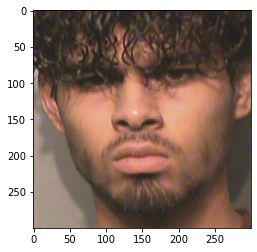

True BMI 19.52582044422172
Predicted BMI 1:  25.817385
Predicted BMI 2:  18.050093
Predicted BMI 3:  20.476046
Predicted BMI 4:  23.139402
Difference:  6.291564275626914
*************************************************************************



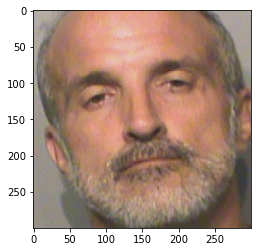

True BMI 27.56519159730233
Predicted BMI 1:  15.948487
Predicted BMI 2:  23.800968
Predicted BMI 3:  25.702883
Predicted BMI 4:  23.250193
Difference:  11.616704315503014
*************************************************************************



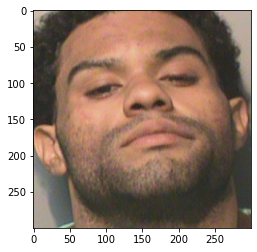

True BMI 30.40955908901437
Predicted BMI 1:  29.062693
Predicted BMI 2:  22.236544
Predicted BMI 3:  30.461592
Predicted BMI 4:  27.357805
Difference:  1.346866446802455
*************************************************************************



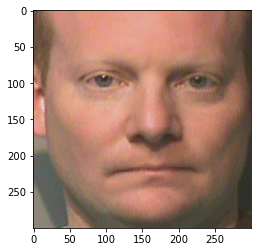

True BMI 24.276163054442392
Predicted BMI 1:  23.687094
Predicted BMI 2:  21.820574
Predicted BMI 3:  30.637175
Predicted BMI 4:  24.448612
Difference:  0.5890693197011814
*************************************************************************



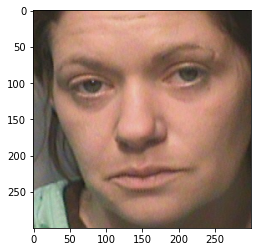

True BMI 24.79961220945369
Predicted BMI 1:  18.898497
Predicted BMI 2:  24.039192
Predicted BMI 3:  27.63893
Predicted BMI 4:  26.270475
Difference:  5.901115581646074
*************************************************************************



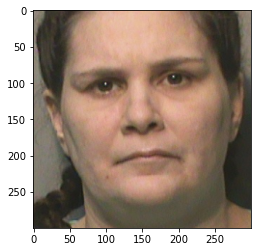

True BMI 26.62546915648521
Predicted BMI 1:  31.427313
Predicted BMI 2:  20.249022
Predicted BMI 3:  29.3099
Predicted BMI 4:  33.58661
Difference:  4.801843694466939
*************************************************************************



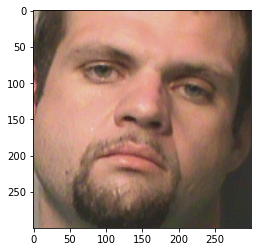

True BMI 27.802690250442232
Predicted BMI 1:  27.178991
Predicted BMI 2:  21.412178
Predicted BMI 3:  29.18464
Predicted BMI 4:  25.667566
Difference:  0.623698932693209
*************************************************************************



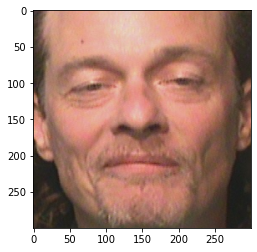

True BMI 23.674772655667763
Predicted BMI 1:  19.570711
Predicted BMI 2:  23.706736
Predicted BMI 3:  25.757627
Predicted BMI 4:  28.225504
Difference:  4.104061519803505
*************************************************************************



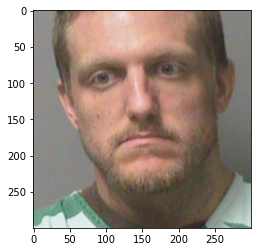

True BMI 30.683432126634138
Predicted BMI 1:  28.220453
Predicted BMI 2:  25.004017
Predicted BMI 3:  31.729553
Predicted BMI 4:  27.400099
Difference:  2.462978864305036
*************************************************************************



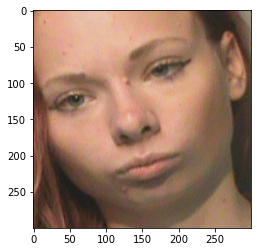

True BMI 18.290036580073163
Predicted BMI 1:  21.60989
Predicted BMI 2:  18.06081
Predicted BMI 3:  31.429125
Predicted BMI 4:  20.918034
Difference:  3.319853404057696
*************************************************************************



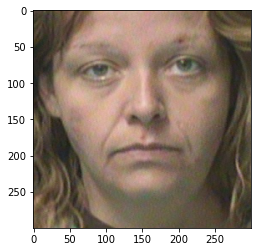

True BMI 31.09306218612437
Predicted BMI 1:  21.465439
Predicted BMI 2:  24.007406
Predicted BMI 3:  29.692564
Predicted BMI 4:  26.69106
Difference:  9.627623343350933
*************************************************************************



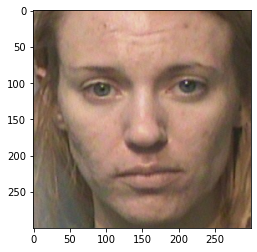

True BMI 24.563012845455955
Predicted BMI 1:  26.070206
Predicted BMI 2:  20.977747
Predicted BMI 3:  22.780659
Predicted BMI 4:  21.142414
Difference:  1.5071928430206079
*************************************************************************



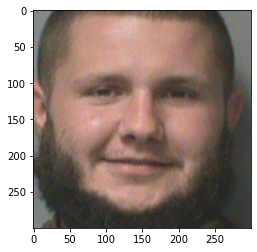

True BMI 26.62546915648521
Predicted BMI 1:  23.507559
Predicted BMI 2:  23.231207
Predicted BMI 3:  30.228807
Predicted BMI 4:  29.656027
Difference:  3.1179103338533736
*************************************************************************



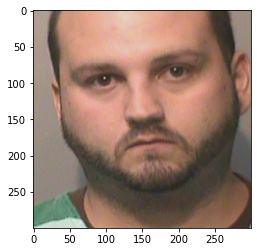

True BMI 29.95323576445969
Predicted BMI 1:  24.332775
Predicted BMI 2:  18.275724
Predicted BMI 3:  31.938885
Predicted BMI 4:  27.625181
Difference:  5.6204606484928945
*************************************************************************



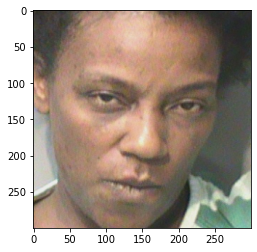

True BMI 22.67355031888242
Predicted BMI 1:  20.195637
Predicted BMI 2:  20.988403
Predicted BMI 3:  26.255707
Predicted BMI 4:  21.020212
Difference:  2.4779135696148415
*************************************************************************



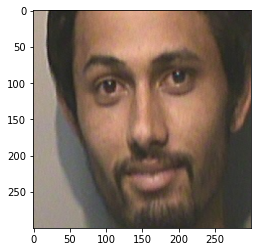

True BMI 21.789328702624346
Predicted BMI 1:  23.37336
Predicted BMI 2:  19.417645
Predicted BMI 3:  22.476166
Predicted BMI 4:  19.299822
Difference:  1.5840309775514356
*************************************************************************



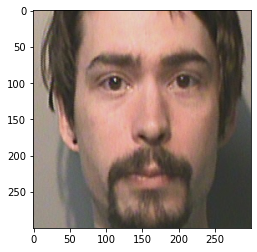

True BMI 20.087685889657493
Predicted BMI 1:  30.3119
Predicted BMI 2:  20.060568
Predicted BMI 3:  21.390694
Predicted BMI 4:  19.171524
Difference:  10.224213295523171
*************************************************************************



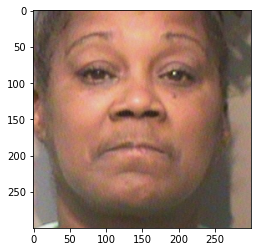

True BMI 29.05243827016579
Predicted BMI 1:  24.999775
Predicted BMI 2:  22.254473
Predicted BMI 3:  29.847626
Predicted BMI 4:  26.349207
Difference:  4.0526633373044625
*************************************************************************



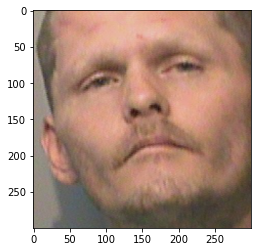

True BMI 26.433746812806127
Predicted BMI 1:  17.355415
Predicted BMI 2:  24.724035
Predicted BMI 3:  33.949123
Predicted BMI 4:  29.612097
Difference:  9.078331468567846
*************************************************************************



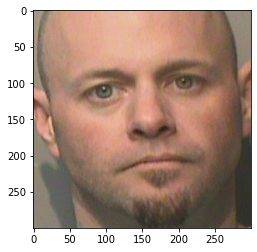

True BMI 21.789328702624346
Predicted BMI 1:  26.472368
Predicted BMI 2:  23.634369
Predicted BMI 3:  28.07933
Predicted BMI 4:  27.758854
Difference:  4.6830395377321
*************************************************************************



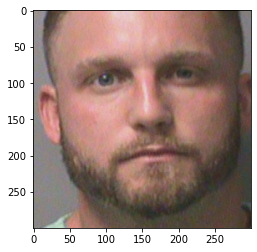

True BMI 34.30248481814284
Predicted BMI 1:  26.954357
Predicted BMI 2:  24.325483
Predicted BMI 3:  27.67303
Predicted BMI 4:  25.560785
Difference:  7.34812767092604
*************************************************************************



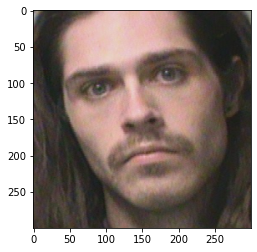

True BMI 19.64525493811014
Predicted BMI 1:  22.168472
Predicted BMI 2:  22.359386
Predicted BMI 3:  25.481585
Predicted BMI 4:  21.594181
Difference:  2.523217351928924
*************************************************************************



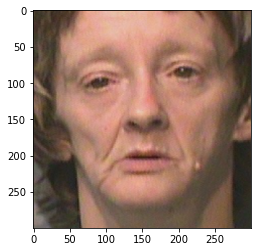

True BMI 18.88124772343295
Predicted BMI 1:  25.930386
Predicted BMI 2:  23.332363
Predicted BMI 3:  24.626274
Predicted BMI 4:  24.48826
Difference:  7.04913786616666
*************************************************************************



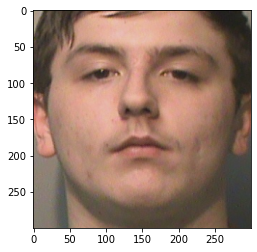

True BMI 28.88908113456365
Predicted BMI 1:  25.7141
Predicted BMI 2:  20.953072
Predicted BMI 3:  28.321716
Predicted BMI 4:  22.98881
Difference:  3.174981250530447
*************************************************************************



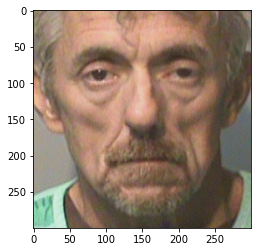

True BMI 27.910111774854933
Predicted BMI 1:  23.433727
Predicted BMI 2:  22.033482
Predicted BMI 3:  25.264082
Predicted BMI 4:  24.094276
Difference:  4.476384510450636
*************************************************************************



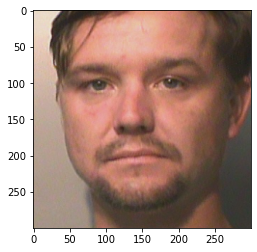

True BMI 22.49820819641639
Predicted BMI 1:  24.707851
Predicted BMI 2:  19.484083
Predicted BMI 3:  25.569767
Predicted BMI 4:  27.309855
Difference:  2.2096432134957205
*************************************************************************



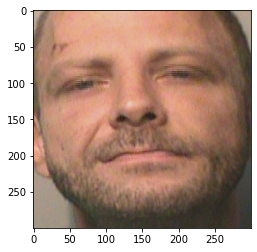

True BMI 22.957355302465707
Predicted BMI 1:  24.391289
Predicted BMI 2:  22.867277
Predicted BMI 3:  28.407248
Predicted BMI 4:  24.72764
Difference:  1.4339334548585114
*************************************************************************



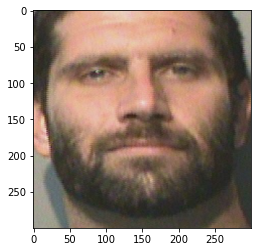

True BMI 28.05778432392824
Predicted BMI 1:  31.348
Predicted BMI 2:  21.512693
Predicted BMI 3:  31.196215
Predicted BMI 4:  28.06915
Difference:  3.2902152488256675
*************************************************************************



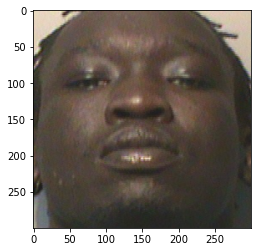

True BMI 23.110376388758617
Predicted BMI 1:  22.489174
Predicted BMI 2:  22.311771
Predicted BMI 3:  25.74855
Predicted BMI 4:  21.785484
Difference:  0.6212024995984606
*************************************************************************



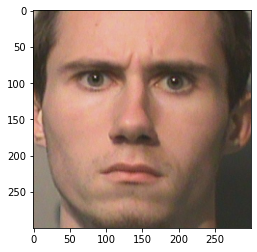

True BMI 20.378811772116297
Predicted BMI 1:  21.048264
Predicted BMI 2:  20.993113
Predicted BMI 3:  25.922152
Predicted BMI 4:  21.29509
Difference:  0.6694517776883906
*************************************************************************



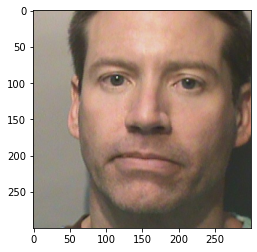

True BMI 23.110376388758617
Predicted BMI 1:  30.23923
Predicted BMI 2:  21.687126
Predicted BMI 3:  25.479233
Predicted BMI 4:  22.819958
Difference:  7.128852813511891
*************************************************************************



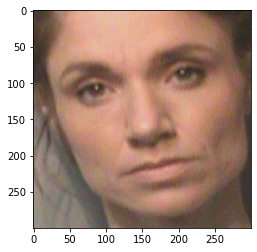

True BMI 22.46492682334477
Predicted BMI 1:  18.728054
Predicted BMI 2:  23.57453
Predicted BMI 3:  22.166443
Predicted BMI 4:  19.839102
Difference:  3.736872776713909
*************************************************************************



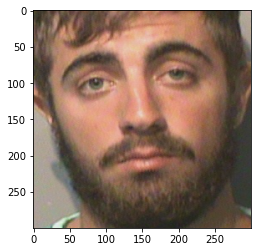

True BMI 22.23993794926365
Predicted BMI 1:  22.694344
Predicted BMI 2:  22.660986
Predicted BMI 3:  24.55764
Predicted BMI 4:  22.00549
Difference:  0.45440561763088283
*************************************************************************



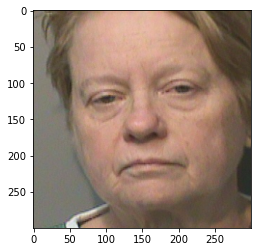

True BMI 21.948043896087796
Predicted BMI 1:  26.263474
Predicted BMI 2:  22.045498
Predicted BMI 3:  35.1637
Predicted BMI 4:  28.664246
Difference:  4.315429614654391
*************************************************************************



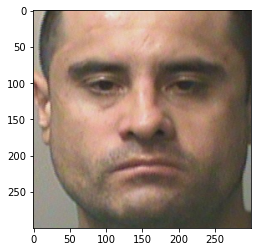

True BMI 27.36860318011293
Predicted BMI 1:  28.756119
Predicted BMI 2:  19.623018
Predicted BMI 3:  26.811226
Predicted BMI 4:  27.511696
Difference:  1.3875155943011315
*************************************************************************



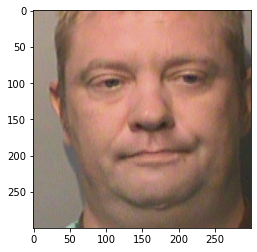

True BMI 28.2891671108786
Predicted BMI 1:  29.466095
Predicted BMI 2:  22.497435
Predicted BMI 3:  34.23487
Predicted BMI 4:  31.063726
Difference:  1.1769278598245236
*************************************************************************



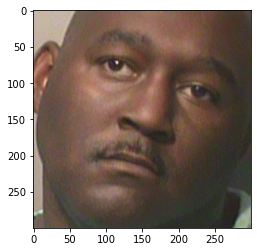

True BMI 33.47283504723724
Predicted BMI 1:  15.554648
Predicted BMI 2:  22.63633
Predicted BMI 3:  23.887321
Predicted BMI 4:  23.607162
Difference:  17.918186647884212
*************************************************************************



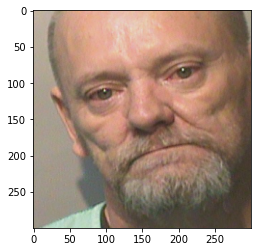

True BMI 31.19326223220348
Predicted BMI 1:  25.184566
Predicted BMI 2:  24.265036
Predicted BMI 3:  28.84965
Predicted BMI 4:  25.100542
Difference:  6.008695734400746
*************************************************************************



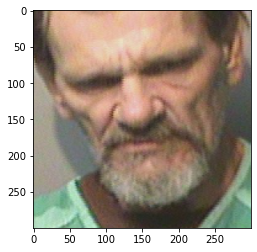

True BMI 22.315223364824828
Predicted BMI 1:  25.64881
Predicted BMI 2:  24.14935
Predicted BMI 3:  35.713593
Predicted BMI 4:  24.3473
Difference:  3.3335860681585707
*************************************************************************



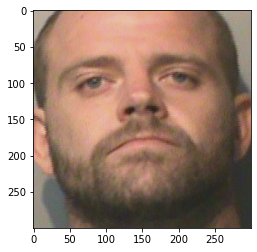

True BMI 31.011235305394365
Predicted BMI 1:  31.873756
Predicted BMI 2:  20.99107
Predicted BMI 3:  28.516754
Predicted BMI 4:  23.794733
Difference:  0.8625211032970412
*************************************************************************



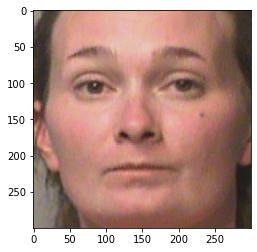

True BMI 23.777047554095116
Predicted BMI 1:  20.67121
Predicted BMI 2:  25.704212
Predicted BMI 3:  27.45989
Predicted BMI 4:  27.623466
Difference:  3.1058382187679676
*************************************************************************



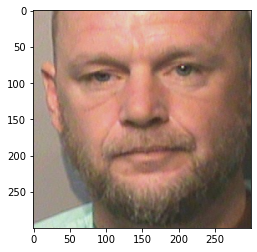

True BMI 27.46709412763501
Predicted BMI 1:  26.837446
Predicted BMI 2:  25.218016
Predicted BMI 3:  29.77277
Predicted BMI 4:  23.722652
Difference:  0.6296479148664567
*************************************************************************



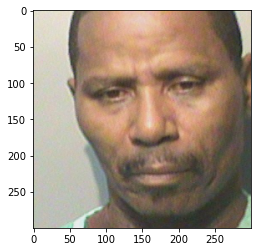

True BMI 27.196678475880255
Predicted BMI 1:  23.795086
Predicted BMI 2:  23.322905
Predicted BMI 3:  28.088396
Predicted BMI 4:  25.541594
Difference:  3.401592568897833
*************************************************************************



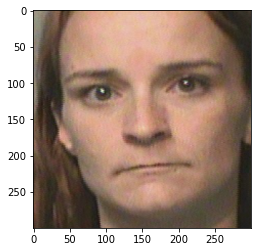

True BMI 17.576725153450305
Predicted BMI 1:  25.549622
Predicted BMI 2:  20.811298
Predicted BMI 3:  21.596508
Predicted BMI 4:  21.282955
Difference:  7.972896428580945
*************************************************************************



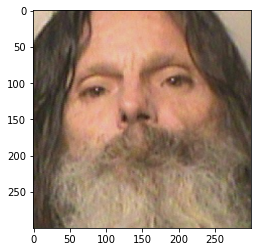

True BMI 21.699660683271983
Predicted BMI 1:  18.356298
Predicted BMI 2:  22.540564
Predicted BMI 3:  23.786234
Predicted BMI 4:  27.765074
Difference:  3.3433622366167093
*************************************************************************



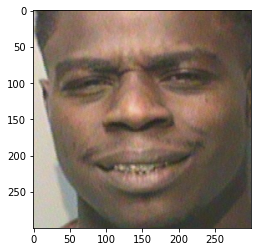

True BMI 21.28669136231006
Predicted BMI 1:  28.398401
Predicted BMI 2:  20.650423
Predicted BMI 3:  27.722832
Predicted BMI 4:  21.819874
Difference:  7.111709898065918
*************************************************************************



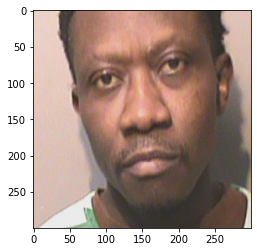

True BMI 24.327647271211497
Predicted BMI 1:  24.061758
Predicted BMI 2:  20.786852
Predicted BMI 3:  27.672071
Predicted BMI 4:  23.376919
Difference:  0.2658892298296607
*************************************************************************



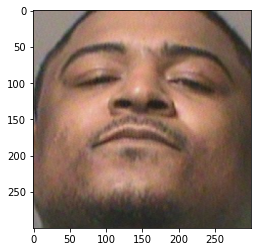

True BMI 36.28147432688184
Predicted BMI 1:  18.43482
Predicted BMI 2:  25.338457
Predicted BMI 3:  31.103289
Predicted BMI 4:  25.406988
Difference:  17.846654151710943
*************************************************************************



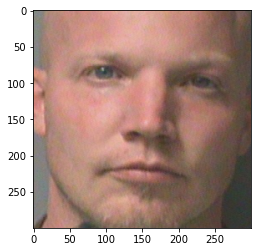

True BMI 24.794622938358295
Predicted BMI 1:  18.661823
Predicted BMI 2:  27.290804
Predicted BMI 3:  31.47298
Predicted BMI 4:  26.406887
Difference:  6.132799665653216
*************************************************************************



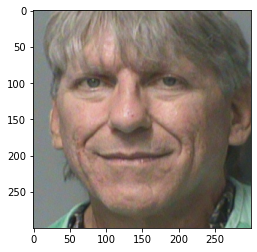

True BMI 29.837033439498978
Predicted BMI 1:  25.0146
Predicted BMI 2:  25.330322
Predicted BMI 3:  26.075918
Predicted BMI 4:  25.940676
Difference:  4.822432685714798
*************************************************************************



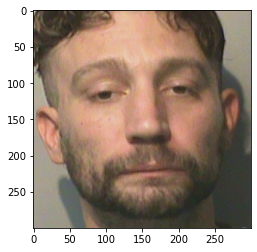

True BMI 27.802690250442232
Predicted BMI 1:  23.927618
Predicted BMI 2:  21.518158
Predicted BMI 3:  25.068787
Predicted BMI 4:  22.002321
Difference:  3.875072223708834
*************************************************************************



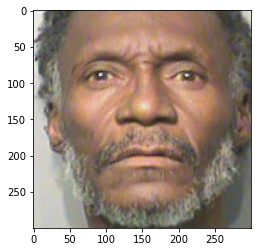

True BMI 24.822640420791046
Predicted BMI 1:  27.307365
Predicted BMI 2:  24.610191
Predicted BMI 3:  26.343761
Predicted BMI 4:  23.178331
Difference:  2.4847249966894225
*************************************************************************



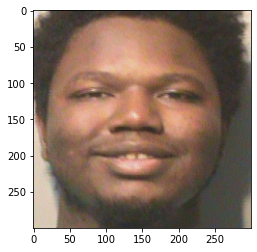

True BMI 30.65077071512168
Predicted BMI 1:  26.828375
Predicted BMI 2:  18.425037
Predicted BMI 3:  30.980547
Predicted BMI 4:  23.45275
Difference:  3.822395852450782
*************************************************************************



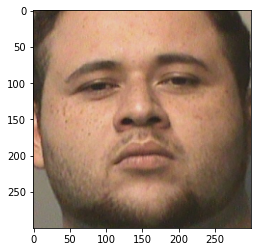

True BMI 34.97099295236653
Predicted BMI 1:  28.836004
Predicted BMI 2:  20.531858
Predicted BMI 3:  31.383373
Predicted BMI 4:  25.839079
Difference:  6.134988695164381
*************************************************************************



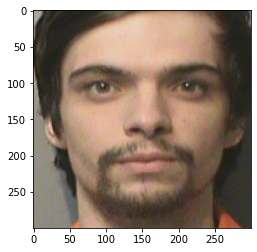

True BMI 22.46492682334477
Predicted BMI 1:  24.132427
Predicted BMI 2:  20.864923
Predicted BMI 3:  21.614527
Predicted BMI 4:  20.467613
Difference:  1.6675003922314033
*************************************************************************



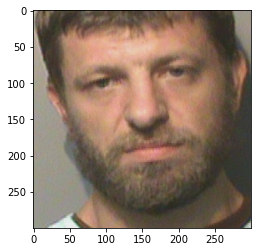

True BMI 26.625098457297508
Predicted BMI 1:  24.60243
Predicted BMI 2:  21.063978
Predicted BMI 3:  26.51911
Predicted BMI 4:  26.889242
Difference:  2.022668113669578
*************************************************************************



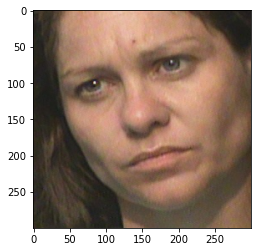

True BMI 22.67355031888242
Predicted BMI 1:  19.70827
Predicted BMI 2:  21.642872
Predicted BMI 3:  23.280878
Predicted BMI 4:  23.685411
Difference:  2.9652811996197244
*************************************************************************



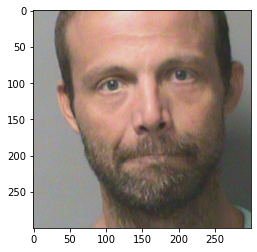

True BMI 22.315223364824828
Predicted BMI 1:  22.774826
Predicted BMI 2:  23.29953
Predicted BMI 3:  21.885027
Predicted BMI 4:  25.736328
Difference:  0.4596026849798598
*************************************************************************



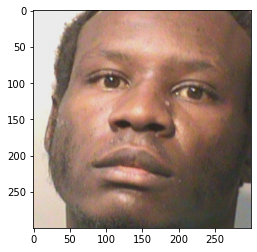

True BMI 26.320150887197315
Predicted BMI 1:  31.61716
Predicted BMI 2:  22.406115
Predicted BMI 3:  29.373909
Predicted BMI 4:  23.315777
Difference:  5.297009909921826
*************************************************************************



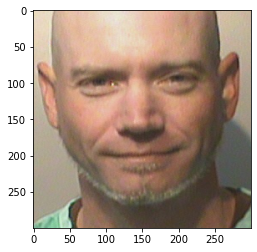

True BMI 22.530462331965307
Predicted BMI 1:  26.27062
Predicted BMI 2:  21.548904
Predicted BMI 3:  29.236923
Predicted BMI 4:  27.964615
Difference:  3.740158014104029
*************************************************************************



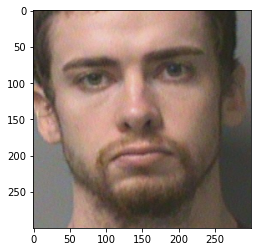

True BMI 21.82646658938314
Predicted BMI 1:  20.622992
Predicted BMI 2:  21.852665
Predicted BMI 3:  22.626617
Predicted BMI 4:  21.122698
Difference:  1.2034750274934929
*************************************************************************



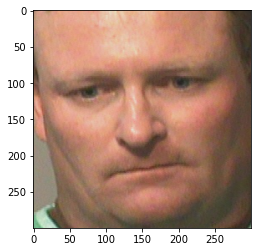

True BMI 29.534509814661305
Predicted BMI 1:  27.123455
Predicted BMI 2:  21.507395
Predicted BMI 3:  27.888193
Predicted BMI 4:  25.32033
Difference:  2.4110547670538836
*************************************************************************



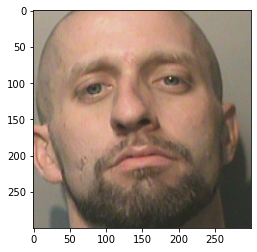

True BMI 25.10433334246211
Predicted BMI 1:  24.515762
Predicted BMI 2:  22.17704
Predicted BMI 3:  26.926117
Predicted BMI 4:  24.581335
Difference:  0.5885710133605464
*************************************************************************



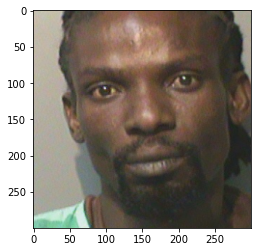

True BMI 20.67415687026291
Predicted BMI 1:  20.406668
Predicted BMI 2:  21.80526
Predicted BMI 3:  23.843266
Predicted BMI 4:  22.249958
Difference:  0.2674891609123229
*************************************************************************



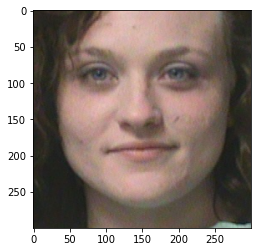

True BMI 25.606051212102425
Predicted BMI 1:  21.977829
Predicted BMI 2:  21.839268
Predicted BMI 3:  25.54061
Predicted BMI 4:  26.057167
Difference:  3.628222232610238
*************************************************************************



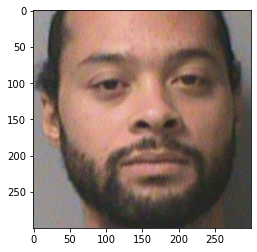

True BMI 21.76888459612911
Predicted BMI 1:  26.6395
Predicted BMI 2:  23.858654
Predicted BMI 3:  30.522621
Predicted BMI 4:  30.175327
Difference:  4.870615068177532
*************************************************************************



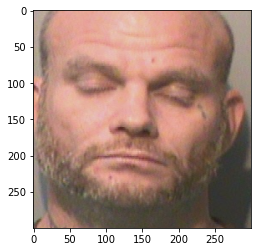

True BMI 31.38078285678491
Predicted BMI 1:  23.610258
Predicted BMI 2:  23.384792
Predicted BMI 3:  29.608297
Predicted BMI 4:  25.61876
Difference:  7.770524754367919
*************************************************************************



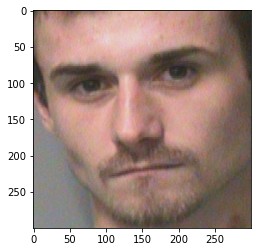

True BMI 26.625098457297508
Predicted BMI 1:  23.717918
Predicted BMI 2:  22.63547
Predicted BMI 3:  22.182703
Predicted BMI 4:  23.1634
Difference:  2.907180061301414
*************************************************************************



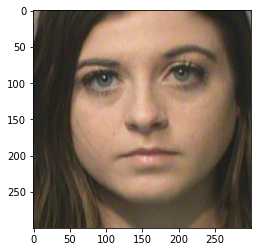

True BMI 21.948043896087796
Predicted BMI 1:  25.090807
Predicted BMI 2:  21.418688
Predicted BMI 3:  26.006346
Predicted BMI 4:  21.110847
Difference:  3.142763064971774
*************************************************************************



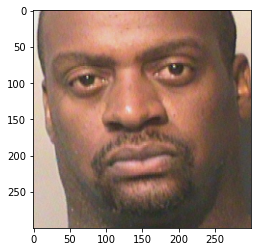

True BMI 32.323495309403825
Predicted BMI 1:  29.17635
Predicted BMI 2:  19.823038
Predicted BMI 3:  26.922985
Predicted BMI 4:  23.157629
Difference:  3.1471456695112465
*************************************************************************



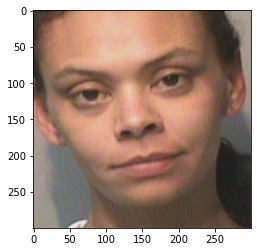

True BMI 21.456995731991015
Predicted BMI 1:  23.35536
Predicted BMI 2:  20.517145
Predicted BMI 3:  25.264696
Predicted BMI 4:  25.363499
Difference:  1.8983642991369152
*************************************************************************



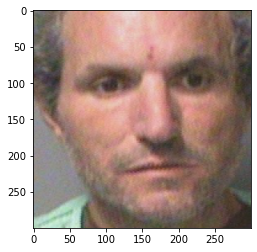

True BMI 26.544442068475973
Predicted BMI 1:  31.570034
Predicted BMI 2:  25.110147
Predicted BMI 3:  27.722878
Predicted BMI 4:  27.004114
Difference:  5.025591958623636
*************************************************************************



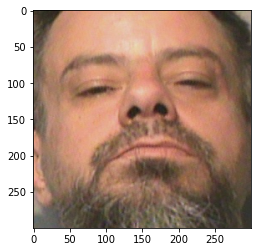

True BMI 27.124575854089983
Predicted BMI 1:  22.771057
Predicted BMI 2:  24.262733
Predicted BMI 3:  29.636496
Predicted BMI 4:  25.69046
Difference:  4.353518725183733
*************************************************************************



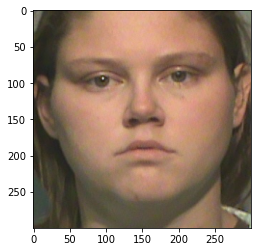

True BMI 25.57550827992281
Predicted BMI 1:  23.917124
Predicted BMI 2:  21.921635
Predicted BMI 3:  30.532465
Predicted BMI 4:  25.448805
Difference:  1.6583844853671472
*************************************************************************



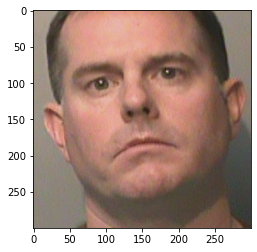

True BMI 28.12884215733829
Predicted BMI 1:  26.340923
Predicted BMI 2:  21.741629
Predicted BMI 3:  28.91654
Predicted BMI 4:  25.633865
Difference:  1.7879188480121186
*************************************************************************



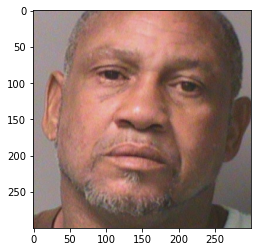

True BMI 35.87086766010266
Predicted BMI 1:  28.373037
Predicted BMI 2:  23.94705
Predicted BMI 3:  31.618689
Predicted BMI 4:  27.574333
Difference:  7.497830321845825
*************************************************************************



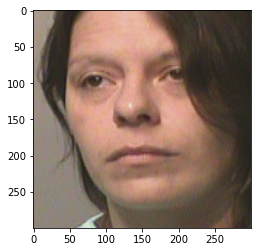

True BMI 25.606051212102425
Predicted BMI 1:  33.745422
Predicted BMI 2:  23.388676
Predicted BMI 3:  24.619165
Predicted BMI 4:  26.809256
Difference:  8.139371151178825
*************************************************************************



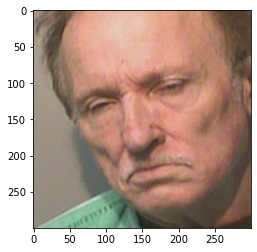

True BMI 20.67415687026291
Predicted BMI 1:  23.0628
Predicted BMI 2:  24.659266
Predicted BMI 3:  27.45889
Predicted BMI 4:  25.208738
Difference:  2.3886425834724427
*************************************************************************



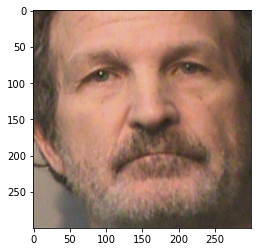

True BMI 24.998009107129327
Predicted BMI 1:  19.353792
Predicted BMI 2:  23.201324
Predicted BMI 3:  28.559011
Predicted BMI 4:  24.436663
Difference:  5.6442169165775695
*************************************************************************



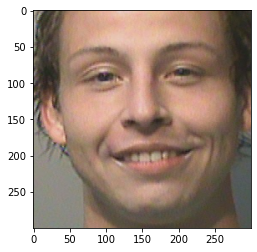

True BMI 21.5225205960616
Predicted BMI 1:  24.116207
Predicted BMI 2:  20.999662
Predicted BMI 3:  26.058048
Predicted BMI 4:  22.439013
Difference:  2.593686526741134
*************************************************************************



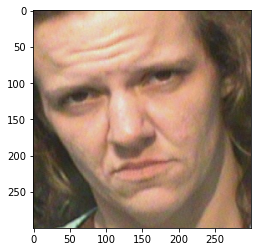

True BMI 33.281373071621886
Predicted BMI 1:  23.666916
Predicted BMI 2:  22.498121
Predicted BMI 3:  24.80825
Predicted BMI 4:  22.781734
Difference:  9.614457178067198
*************************************************************************



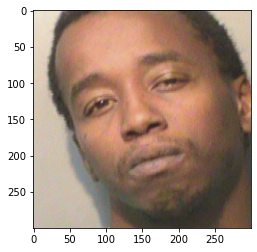

True BMI 25.10462628542793
Predicted BMI 1:  28.75484
Predicted BMI 2:  19.66014
Predicted BMI 3:  25.980743
Predicted BMI 4:  24.284805
Difference:  3.6502145654021483
*************************************************************************



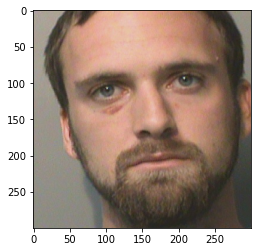

True BMI 21.789328702624346
Predicted BMI 1:  26.216028
Predicted BMI 2:  22.110529
Predicted BMI 3:  27.104502
Predicted BMI 4:  26.229076
Difference:  4.426699510876631
*************************************************************************



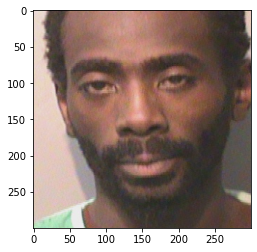

True BMI 24.327647271211497
Predicted BMI 1:  19.556889
Predicted BMI 2:  17.914793
Predicted BMI 3:  23.018393
Predicted BMI 4:  21.58423
Difference:  4.770758690889231
*************************************************************************



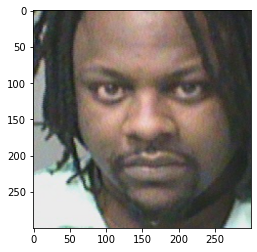

True BMI 30.40955908901437
Predicted BMI 1:  24.624018
Predicted BMI 2:  23.145119
Predicted BMI 3:  27.382002
Predicted BMI 4:  25.297487
Difference:  5.785541373560267
*************************************************************************



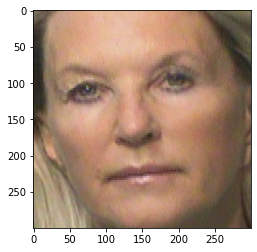

True BMI 21.948043896087796
Predicted BMI 1:  19.490313
Predicted BMI 2:  22.173864
Predicted BMI 3:  26.466396
Predicted BMI 4:  24.98383
Difference:  2.457731319793851
*************************************************************************



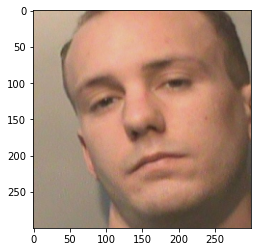

True BMI 23.05588947597648
Predicted BMI 1:  20.953701
Predicted BMI 2:  21.058525
Predicted BMI 3:  28.984005
Predicted BMI 4:  24.55156
Difference:  2.102188456689369
*************************************************************************



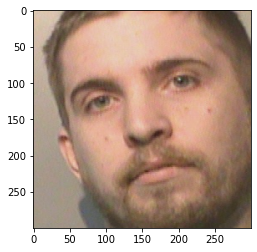

True BMI 32.9831584789835
Predicted BMI 1:  19.294628
Predicted BMI 2:  21.400518
Predicted BMI 3:  27.864384
Predicted BMI 4:  25.977163
Difference:  13.68853033567295
*************************************************************************



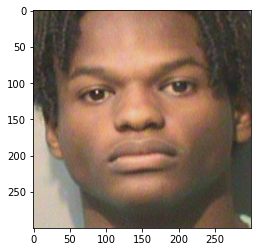

True BMI 22.377775079624232
Predicted BMI 1:  29.295729
Predicted BMI 2:  22.060432
Predicted BMI 3:  24.15482
Predicted BMI 4:  21.165552
Difference:  6.917953603847447
*************************************************************************



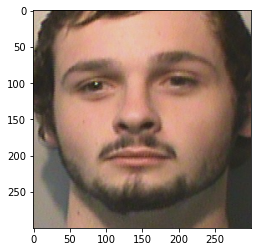

True BMI 22.428547765708775
Predicted BMI 1:  32.510857
Predicted BMI 2:  21.417292
Predicted BMI 3:  29.432299
Predicted BMI 4:  28.609661
Difference:  10.082308862709194
*************************************************************************



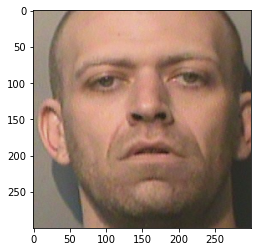

True BMI 24.327647271211497
Predicted BMI 1:  25.765446
Predicted BMI 2:  21.217163
Predicted BMI 3:  25.916304
Predicted BMI 4:  24.914515
Difference:  1.437798438017019
*************************************************************************



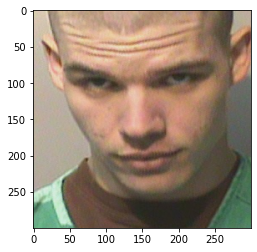

True BMI 22.49820819641639
Predicted BMI 1:  26.466143
Predicted BMI 2:  24.979095
Predicted BMI 3:  22.682413
Predicted BMI 4:  23.777998
Difference:  3.9679344580025564
*************************************************************************



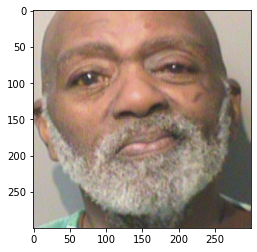

True BMI 26.938709970090915
Predicted BMI 1:  16.839708
Predicted BMI 2:  23.375263
Predicted BMI 3:  21.498312
Predicted BMI 4:  22.767187
Difference:  10.099001641843845
*************************************************************************



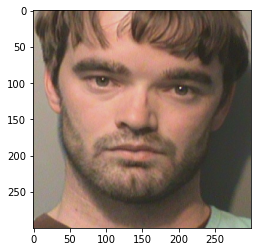

True BMI 29.05243827016579
Predicted BMI 1:  26.683214
Predicted BMI 2:  21.141895
Predicted BMI 3:  25.949274
Predicted BMI 4:  25.581564
Difference:  2.3692240825437203
*************************************************************************



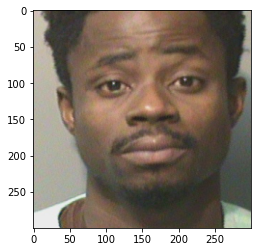

True BMI 21.632892496554224
Predicted BMI 1:  23.347826
Predicted BMI 2:  20.607958
Predicted BMI 3:  27.33745
Predicted BMI 4:  22.404716
Difference:  1.7149335074740968
*************************************************************************



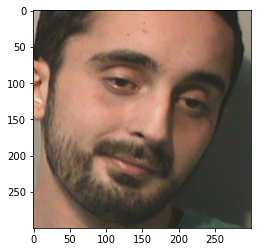

True BMI 24.39219000886981
Predicted BMI 1:  20.814354
Predicted BMI 2:  20.099796
Predicted BMI 3:  26.691877
Predicted BMI 4:  21.173454
Difference:  3.577836065998717
*************************************************************************



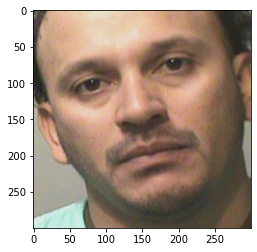

True BMI 21.699660683271983
Predicted BMI 1:  23.688437
Predicted BMI 2:  20.49862
Predicted BMI 3:  28.420155
Predicted BMI 4:  27.59955
Difference:  1.9887758249067282
*************************************************************************



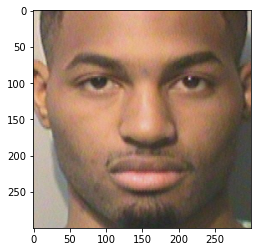

True BMI 22.315223364824828
Predicted BMI 1:  24.61998
Predicted BMI 2:  18.02286
Predicted BMI 3:  23.044556
Predicted BMI 4:  20.251133
Difference:  2.30475649357361
*************************************************************************



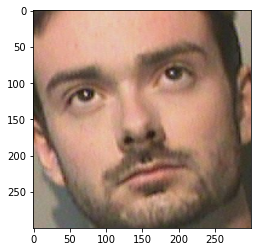

True BMI 18.987203097862988
Predicted BMI 1:  19.921013
Predicted BMI 2:  21.717794
Predicted BMI 3:  24.395584
Predicted BMI 4:  19.648792
Difference:  0.9338097805549808
*************************************************************************



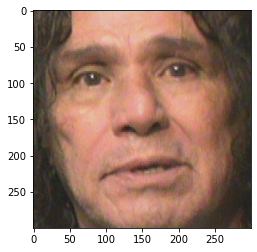

True BMI 31.011235305394365
Predicted BMI 1:  19.993185
Predicted BMI 2:  23.430029
Predicted BMI 3:  28.370691
Predicted BMI 4:  26.242712
Difference:  11.018050262059404
*************************************************************************



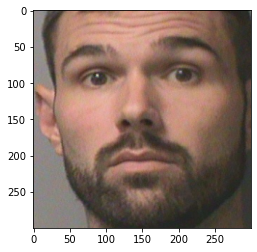

True BMI 25.03624108782184
Predicted BMI 1:  26.675488
Predicted BMI 2:  20.33346
Predicted BMI 3:  26.248503
Predicted BMI 4:  25.44099
Difference:  1.6392464304887078
*************************************************************************



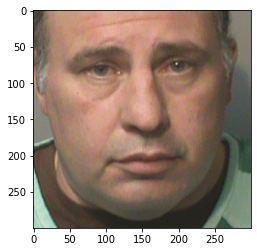

True BMI 33.08749914102216
Predicted BMI 1:  23.683977
Predicted BMI 2:  24.719646
Predicted BMI 3:  31.673584
Predicted BMI 4:  25.635616
Difference:  9.403522013946962
*************************************************************************



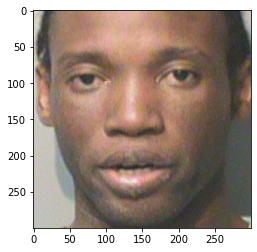

True BMI 23.403353050966885
Predicted BMI 1:  26.592802
Predicted BMI 2:  22.627817
Predicted BMI 3:  23.77075
Predicted BMI 4:  20.057674
Difference:  3.189448996762607
*************************************************************************



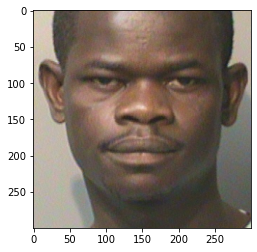

True BMI 24.21036522513816
Predicted BMI 1:  23.256218
Predicted BMI 2:  22.004583
Predicted BMI 3:  22.857538
Predicted BMI 4:  22.279335
Difference:  0.9541472685951895
*************************************************************************



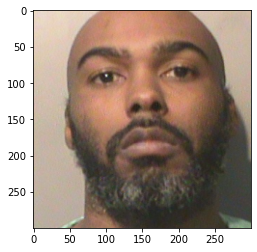

True BMI 25.82702471527392
Predicted BMI 1:  26.308474
Predicted BMI 2:  21.294758
Predicted BMI 3:  26.832947
Predicted BMI 4:  22.333479
Difference:  0.4814488717622112
*************************************************************************



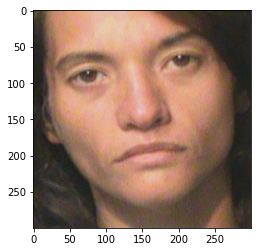

True BMI 22.14251090129794
Predicted BMI 1:  25.228773
Predicted BMI 2:  24.77678
Predicted BMI 3:  18.709984
Predicted BMI 4:  19.115437
Difference:  3.0862622157674906
*************************************************************************



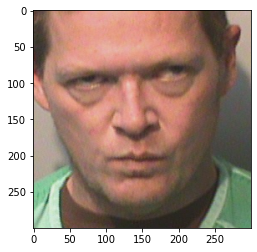

True BMI 31.19326223220348
Predicted BMI 1:  23.569632
Predicted BMI 2:  25.179743
Predicted BMI 3:  29.984222
Predicted BMI 4:  30.43395
Difference:  7.623630655665394
*************************************************************************



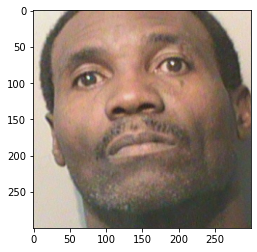

True BMI 28.661534444922307
Predicted BMI 1:  26.155313
Predicted BMI 2:  21.294971
Predicted BMI 3:  24.764137
Predicted BMI 4:  24.086388
Difference:  2.5062209531010176
*************************************************************************



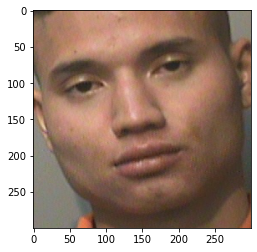

True BMI 19.72530387840564
Predicted BMI 1:  21.027311
Predicted BMI 2:  21.263927
Predicted BMI 3:  24.140396
Predicted BMI 4:  21.571674
Difference:  1.3020074466676022
*************************************************************************



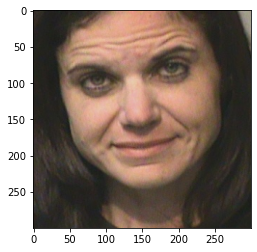

True BMI 20.36065288437104
Predicted BMI 1:  21.316402
Predicted BMI 2:  20.851202
Predicted BMI 3:  24.178345
Predicted BMI 4:  21.172613
Difference:  0.9557495509316958
*************************************************************************



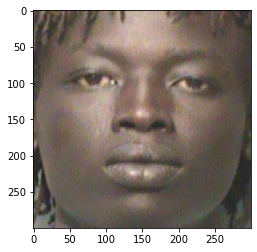

True BMI 18.987203097862988
Predicted BMI 1:  19.414062
Predicted BMI 2:  21.499407
Predicted BMI 3:  25.73834
Predicted BMI 4:  20.078978
Difference:  0.426859402137012
*************************************************************************



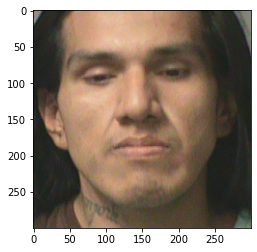

True BMI 36.76022801531182
Predicted BMI 1:  25.531809
Predicted BMI 2:  21.764606
Predicted BMI 3:  26.230377
Predicted BMI 4:  27.052553
Difference:  11.228419162162403
*************************************************************************



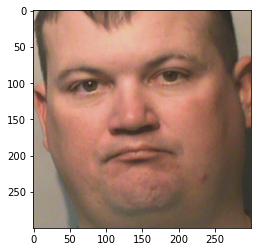

True BMI 31.19326223220348
Predicted BMI 1:  28.31347
Predicted BMI 2:  21.583052
Predicted BMI 3:  33.259346
Predicted BMI 4:  29.478596
Difference:  2.8797913917493787
*************************************************************************



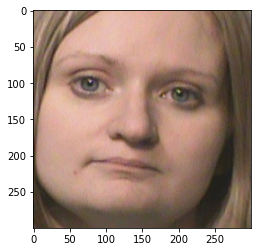

True BMI 29.534509814661305
Predicted BMI 1:  23.410852
Predicted BMI 2:  19.962723
Predicted BMI 3:  30.140703
Predicted BMI 4:  29.073929
Difference:  6.123657382410329
*************************************************************************



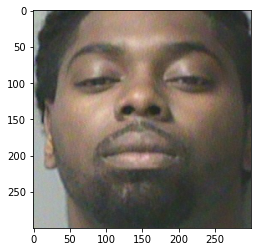

True BMI 27.49781001784225
Predicted BMI 1:  26.914589
Predicted BMI 2:  21.853172
Predicted BMI 3:  31.480892
Predicted BMI 4:  29.404755
Difference:  0.5832210896195953
*************************************************************************



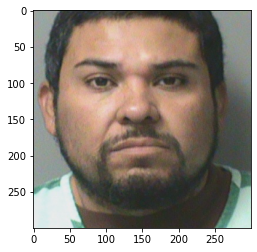

True BMI 29.28760830302725
Predicted BMI 1:  31.701172
Predicted BMI 2:  24.936306
Predicted BMI 3:  33.624687
Predicted BMI 4:  34.349148
Difference:  2.4135635719727517
*************************************************************************



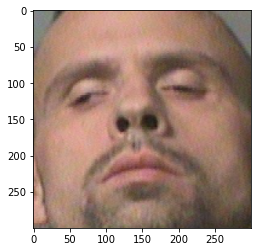

True BMI 26.58105883319517
Predicted BMI 1:  14.738196
Predicted BMI 2:  24.924576
Predicted BMI 3:  30.556852
Predicted BMI 4:  25.444284
Difference:  11.842862460209329
*************************************************************************



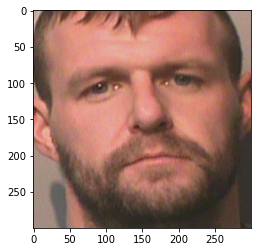

True BMI 25.768347061385484
Predicted BMI 1:  23.963219
Predicted BMI 2:  22.731466
Predicted BMI 3:  29.462456
Predicted BMI 4:  28.377438
Difference:  1.80512837242064
*************************************************************************



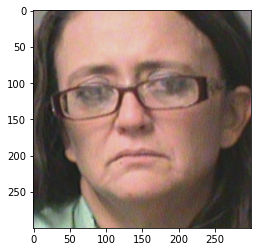

True BMI 25.848125225662216
Predicted BMI 1:  28.389502
Predicted BMI 2:  25.67413
Predicted BMI 3:  34.443268
Predicted BMI 4:  26.397303
Difference:  2.541376345993058
*************************************************************************



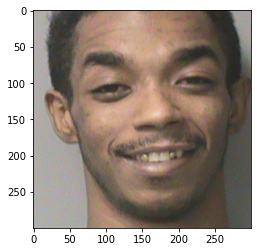

True BMI 18.652851183253382
Predicted BMI 1:  19.202934
Predicted BMI 2:  20.823807
Predicted BMI 3:  22.513502
Predicted BMI 4:  21.099909
Difference:  0.5500830818833364
*************************************************************************



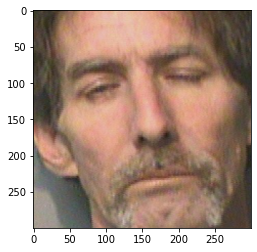

True BMI 18.24573545340862
Predicted BMI 1:  13.909048
Predicted BMI 2:  22.986368
Predicted BMI 3:  23.708775
Predicted BMI 4:  23.314426
Difference:  4.336687372964285
*************************************************************************



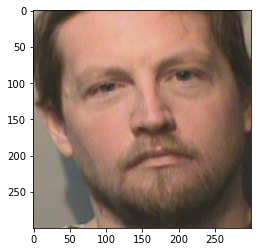

True BMI 27.705853122346134
Predicted BMI 1:  24.431547
Predicted BMI 2:  22.765182
Predicted BMI 3:  29.013273
Predicted BMI 4:  24.235065
Difference:  3.274305957429142
*************************************************************************



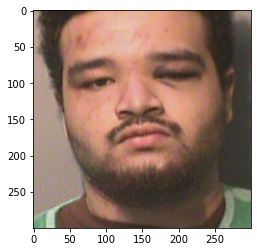

True BMI 30.40955908901437
Predicted BMI 1:  23.02611
Predicted BMI 2:  21.38694
Predicted BMI 3:  27.839294
Predicted BMI 4:  31.029541
Difference:  7.383449393579799
*************************************************************************



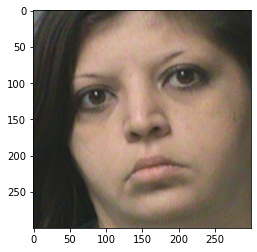

True BMI 31.885215697869032
Predicted BMI 1:  20.1775
Predicted BMI 2:  23.251942
Predicted BMI 3:  37.275013
Predicted BMI 4:  25.498953
Difference:  11.707715926750868
*************************************************************************



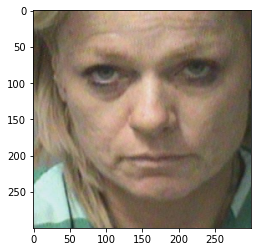

True BMI 22.31420185496621
Predicted BMI 1:  25.866919
Predicted BMI 2:  21.431435
Predicted BMI 3:  26.958448
Predicted BMI 4:  25.907728
Difference:  3.552716708876563
*************************************************************************



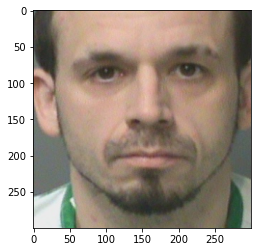

True BMI 25.23993404388193
Predicted BMI 1:  22.511469
Predicted BMI 2:  20.590908
Predicted BMI 3:  27.088902
Predicted BMI 4:  25.278269
Difference:  2.7284651565528293
*************************************************************************



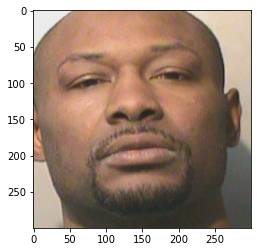

True BMI 26.247909562485788
Predicted BMI 1:  27.265911
Predicted BMI 2:  21.823149
Predicted BMI 3:  34.397087
Predicted BMI 4:  23.489927
Difference:  1.0180015398091342
*************************************************************************



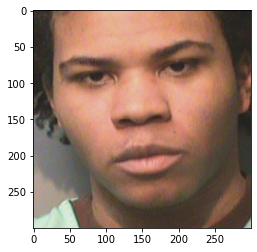

True BMI 28.191673224513742
Predicted BMI 1:  27.678627
Predicted BMI 2:  22.880817
Predicted BMI 3:  28.869698
Predicted BMI 4:  23.65916
Difference:  0.5130462103535862
*************************************************************************



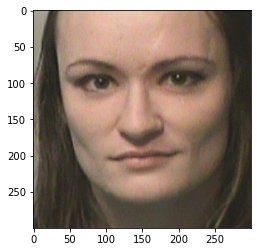

True BMI 22.150882360995976
Predicted BMI 1:  26.639933
Predicted BMI 2:  21.672318
Predicted BMI 3:  22.186293
Predicted BMI 4:  23.298317
Difference:  4.4890502714503135
*************************************************************************



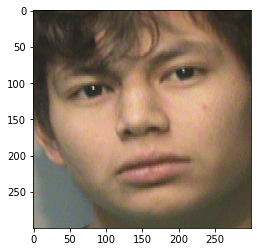

True BMI 25.059265088456662
Predicted BMI 1:  22.333227
Predicted BMI 2:  18.045073
Predicted BMI 3:  22.597134
Predicted BMI 4:  23.62279
Difference:  2.726037930863889
*************************************************************************



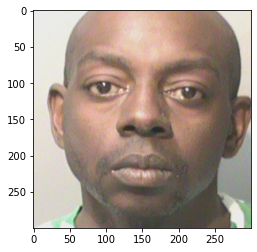

True BMI 25.848125225662216
Predicted BMI 1:  27.098402
Predicted BMI 2:  23.307405
Predicted BMI 3:  27.178263
Predicted BMI 4:  22.955276
Difference:  1.250276797653214
*************************************************************************



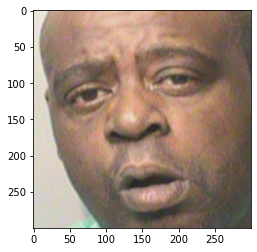

True BMI 37.58889763268499
Predicted BMI 1:  26.598866
Predicted BMI 2:  22.748804
Predicted BMI 3:  30.8515
Predicted BMI 4:  28.681932
Difference:  10.990032123651787
*************************************************************************



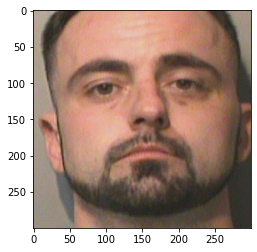

True BMI 28.191673224513742
Predicted BMI 1:  27.323063
Predicted BMI 2:  20.692886
Predicted BMI 3:  28.391535
Predicted BMI 4:  23.608517
Difference:  0.8686103277852268
*************************************************************************



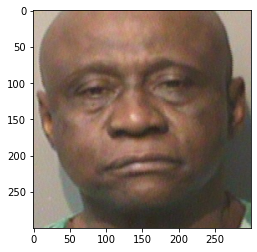

True BMI 29.75787729254229
Predicted BMI 1:  26.38343
Predicted BMI 2:  20.56778
Predicted BMI 3:  27.79283
Predicted BMI 4:  25.430471
Difference:  3.3744468115852584
*************************************************************************



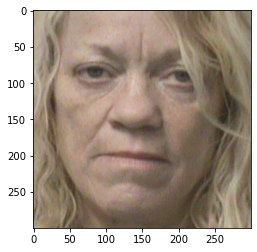

True BMI 22.79774055406099
Predicted BMI 1:  14.883768
Predicted BMI 2:  17.957775
Predicted BMI 3:  30.351456
Predicted BMI 4:  22.890152
Difference:  7.913972472395951
*************************************************************************



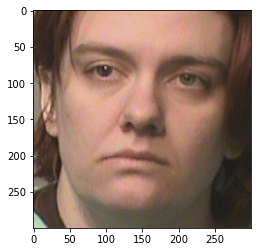

True BMI 31.011235305394365
Predicted BMI 1:  27.101315
Predicted BMI 2:  23.67564
Predicted BMI 3:  28.176188
Predicted BMI 4:  24.90914
Difference:  3.9099207607166306
*************************************************************************



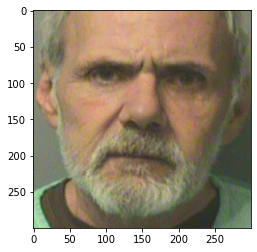

True BMI 27.261859421678025
Predicted BMI 1:  26.449085
Predicted BMI 2:  22.121952
Predicted BMI 3:  26.489485
Predicted BMI 4:  26.571785
Difference:  0.8127741860823221
*************************************************************************



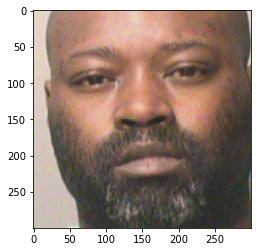

True BMI 31.324081360570837
Predicted BMI 1:  28.153988
Predicted BMI 2:  20.819534
Predicted BMI 3:  26.639004
Predicted BMI 4:  25.884604
Difference:  3.1700934760493524
*************************************************************************



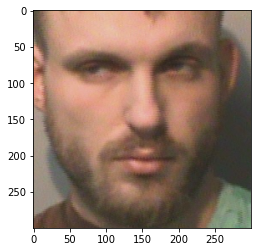

True BMI 25.090232665033227
Predicted BMI 1:  21.440361
Predicted BMI 2:  18.338856
Predicted BMI 3:  25.588062
Predicted BMI 4:  25.008795
Difference:  3.6498716420840083
*************************************************************************



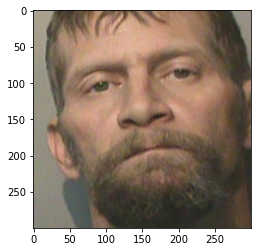

True BMI 23.012574094975605
Predicted BMI 1:  23.614077
Predicted BMI 2:  22.152565
Predicted BMI 3:  28.332205
Predicted BMI 4:  23.750423
Difference:  0.6015025194042778
*************************************************************************



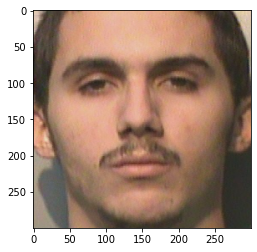

True BMI 20.44955825696977
Predicted BMI 1:  27.611876
Predicted BMI 2:  17.33317
Predicted BMI 3:  26.797548
Predicted BMI 4:  23.23482
Difference:  7.162317277087848
*************************************************************************



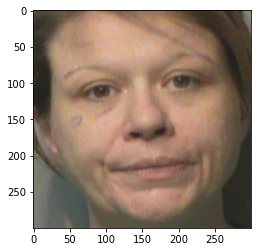

True BMI 29.95323576445969
Predicted BMI 1:  24.098577
Predicted BMI 2:  23.923464
Predicted BMI 3:  28.789282
Predicted BMI 4:  31.941252
Difference:  5.854658265070043
*************************************************************************



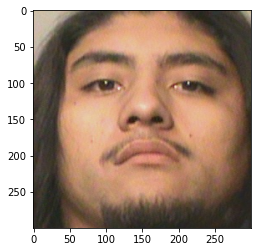

True BMI 28.12884215733829
Predicted BMI 1:  21.690018
Predicted BMI 2:  22.93562
Predicted BMI 3:  24.914576
Predicted BMI 4:  22.958242
Difference:  6.438824457142978
*************************************************************************



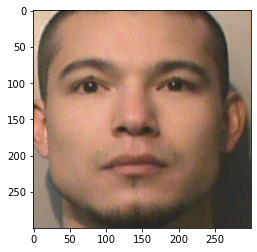

True BMI 25.62295933480756
Predicted BMI 1:  25.640135
Predicted BMI 2:  20.965202
Predicted BMI 3:  26.994795
Predicted BMI 4:  23.7667
Difference:  0.017175476593806138
*************************************************************************



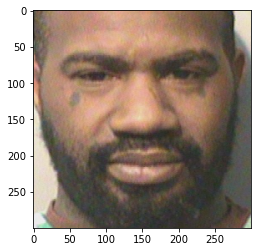

True BMI 24.39219000886981
Predicted BMI 1:  23.845495
Predicted BMI 2:  19.665318
Predicted BMI 3:  27.744984
Predicted BMI 4:  23.44963
Difference:  0.5466947848707875
*************************************************************************



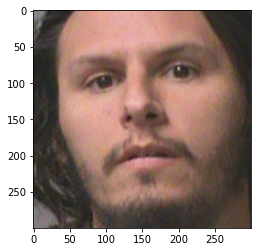

True BMI 21.926856952399586
Predicted BMI 1:  23.382298
Predicted BMI 2:  23.630644
Predicted BMI 3:  30.686804
Predicted BMI 4:  28.245012
Difference:  1.4554405634695549
*************************************************************************



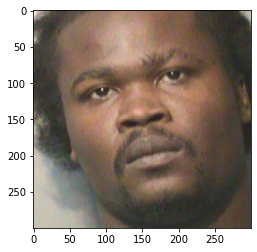

True BMI 24.39219000886981
Predicted BMI 1:  23.725496
Predicted BMI 2:  22.51394
Predicted BMI 3:  25.558542
Predicted BMI 4:  25.628426
Difference:  0.6666937167555531
*************************************************************************



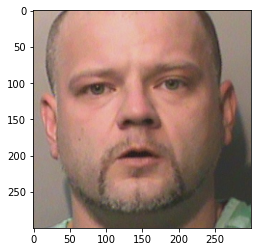

True BMI 25.90396994065593
Predicted BMI 1:  27.880404
Predicted BMI 2:  22.859343
Predicted BMI 3:  32.395622
Predicted BMI 4:  34.16959
Difference:  1.9764335780208278
*************************************************************************



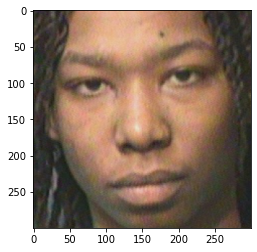

True BMI 24.030678920732843
Predicted BMI 1:  23.995403
Predicted BMI 2:  22.755116
Predicted BMI 3:  26.0159
Predicted BMI 4:  22.089981
Difference:  0.035275630937920965
*************************************************************************



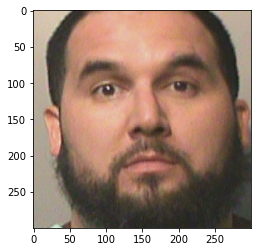

True BMI 37.6569394281419
Predicted BMI 1:  24.220074
Predicted BMI 2:  20.498625
Predicted BMI 3:  32.028816
Predicted BMI 4:  28.977665
Difference:  13.436865728190725
*************************************************************************



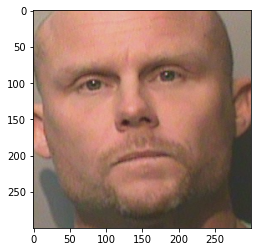

True BMI 25.82702471527392
Predicted BMI 1:  26.442728
Predicted BMI 2:  23.687954
Predicted BMI 3:  30.211279
Predicted BMI 4:  30.148474
Difference:  0.6157033273286174
*************************************************************************



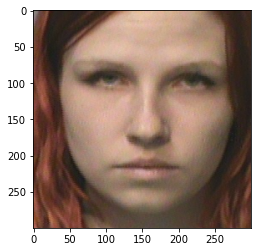

True BMI 17.924235848471696
Predicted BMI 1:  21.56015
Predicted BMI 2:  18.43908
Predicted BMI 3:  23.879246
Predicted BMI 4:  23.628412
Difference:  3.635914298012679
*************************************************************************



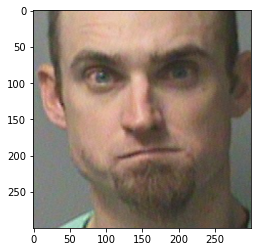

True BMI 25.03624108782184
Predicted BMI 1:  24.368744
Predicted BMI 2:  21.825912
Predicted BMI 3:  22.440796
Predicted BMI 4:  21.052855
Difference:  0.6674971913374641
*************************************************************************



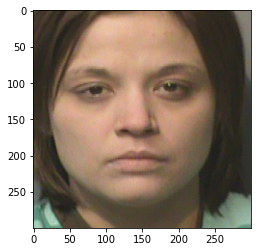

True BMI 27.456713517609444
Predicted BMI 1:  27.317997
Predicted BMI 2:  20.219837
Predicted BMI 3:  31.936949
Predicted BMI 4:  26.073473
Difference:  0.13871653884967827
*************************************************************************



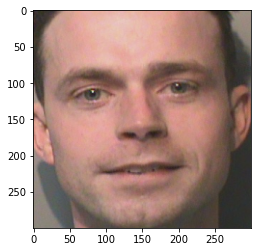

True BMI 23.62760785172904
Predicted BMI 1:  18.138865
Predicted BMI 2:  24.229097
Predicted BMI 3:  26.473831
Predicted BMI 4:  23.785536
Difference:  5.488743334517125
*************************************************************************



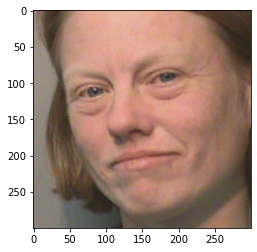

True BMI 24.21036522513816
Predicted BMI 1:  25.16187
Predicted BMI 2:  19.875544
Predicted BMI 3:  29.0315
Predicted BMI 4:  25.341919
Difference:  0.9515038239341074
*************************************************************************



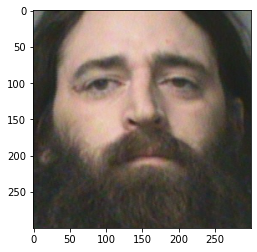

True BMI 23.05588947597648
Predicted BMI 1:  21.910395
Predicted BMI 2:  21.841854
Predicted BMI 3:  25.575596
Predicted BMI 4:  21.618338
Difference:  1.1454948073973767
*************************************************************************



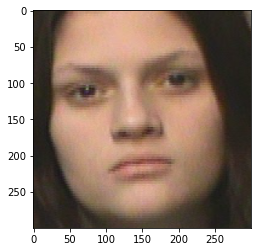

True BMI 23.02821133734986
Predicted BMI 1:  27.316078
Predicted BMI 2:  21.898216
Predicted BMI 3:  23.081684
Predicted BMI 4:  25.434973
Difference:  4.287866848685297
*************************************************************************



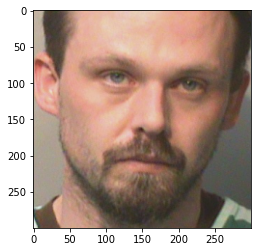

True BMI 26.58105883319517
Predicted BMI 1:  25.653048
Predicted BMI 2:  21.292673
Predicted BMI 3:  24.39347
Predicted BMI 4:  27.767214
Difference:  0.9280112715496607
*************************************************************************



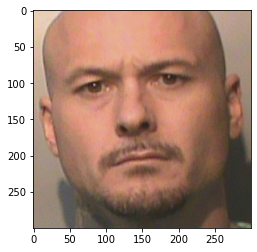

True BMI 32.09774498438697
Predicted BMI 1:  24.92945
Predicted BMI 2:  20.863344
Predicted BMI 3:  27.922436
Predicted BMI 4:  23.35433
Difference:  7.168295902966072
*************************************************************************



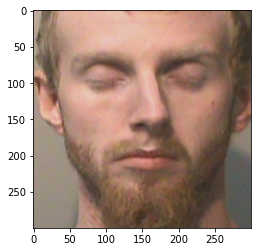

True BMI 20.087685889657493
Predicted BMI 1:  22.27377
Predicted BMI 2:  21.17868
Predicted BMI 3:  27.445948
Predicted BMI 4:  24.602644
Difference:  2.1860834890046164
*************************************************************************



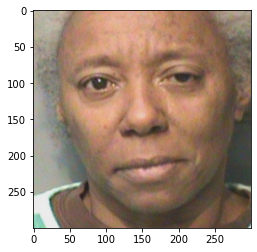

True BMI 24.23679423630033
Predicted BMI 1:  26.191896
Predicted BMI 2:  22.748804
Predicted BMI 3:  30.203743
Predicted BMI 4:  23.771872
Difference:  1.9551022022983027
*************************************************************************



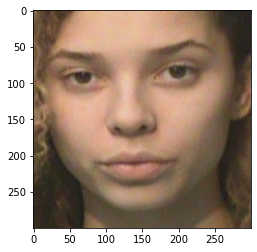

True BMI 24.365970597095576
Predicted BMI 1:  21.784918
Predicted BMI 2:  20.843996
Predicted BMI 3:  23.834913
Predicted BMI 4:  21.146511
Difference:  2.581052765674677
*************************************************************************



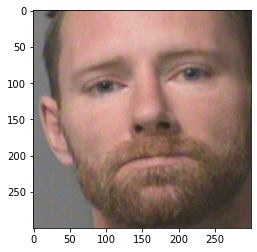

True BMI 28.191673224513742
Predicted BMI 1:  22.052298
Predicted BMI 2:  25.355213
Predicted BMI 3:  26.381367
Predicted BMI 4:  21.19147
Difference:  6.1393756323506565
*************************************************************************



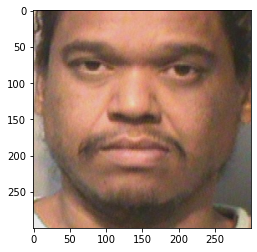

True BMI 31.73575374928528
Predicted BMI 1:  26.80213
Predicted BMI 2:  20.138565
Predicted BMI 3:  26.050177
Predicted BMI 4:  25.4222
Difference:  4.9336240038018815
*************************************************************************



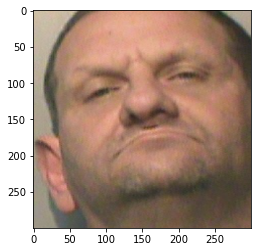

True BMI 33.90571981761247
Predicted BMI 1:  24.619041
Predicted BMI 2:  22.9998
Predicted BMI 3:  30.99286
Predicted BMI 4:  35.653297
Difference:  9.286678374741378
*************************************************************************



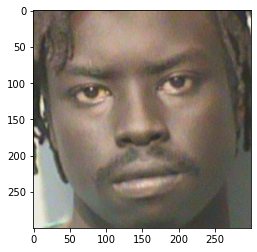

True BMI 18.86698337108585
Predicted BMI 1:  18.530602
Predicted BMI 2:  21.38859
Predicted BMI 3:  21.64811
Predicted BMI 4:  18.92045
Difference:  0.33638186962100747
*************************************************************************



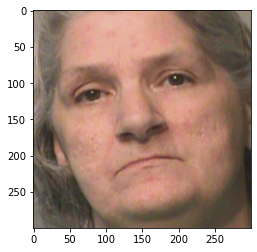

True BMI 34.45648949662791
Predicted BMI 1:  23.26005
Predicted BMI 2:  23.597008
Predicted BMI 3:  31.540913
Predicted BMI 4:  26.256748
Difference:  11.19643967668162
*************************************************************************



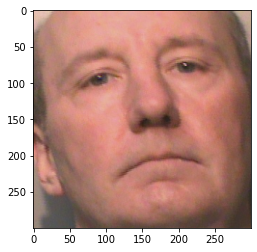

True BMI 26.3865267831868
Predicted BMI 1:  13.852685
Predicted BMI 2:  22.63182
Predicted BMI 3:  27.752527
Predicted BMI 4:  24.177399
Difference:  12.533841808516389
*************************************************************************



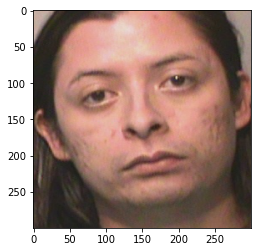

True BMI 20.67415687026291
Predicted BMI 1:  23.119518
Predicted BMI 2:  23.868542
Predicted BMI 3:  29.797146
Predicted BMI 4:  26.708933
Difference:  2.445361409766388
*************************************************************************



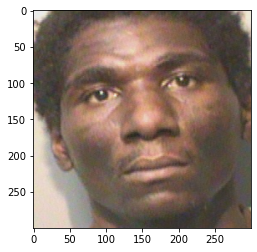

True BMI 22.23993794926365
Predicted BMI 1:  22.16021
Predicted BMI 2:  21.254602
Predicted BMI 3:  23.072441
Predicted BMI 4:  21.097769
Difference:  0.07972829350192967
*************************************************************************



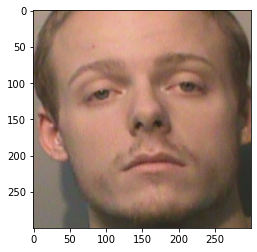

True BMI 25.10433334246211
Predicted BMI 1:  24.66142
Predicted BMI 2:  22.479479
Predicted BMI 3:  22.009544
Predicted BMI 4:  22.334711
Difference:  0.4429125203185542
*************************************************************************



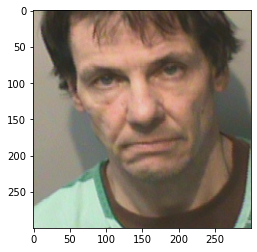

True BMI 26.60836420288757
Predicted BMI 1:  22.745111
Predicted BMI 2:  20.982496
Predicted BMI 3:  23.734674
Predicted BMI 4:  24.286974
Difference:  3.86325273743347
*************************************************************************



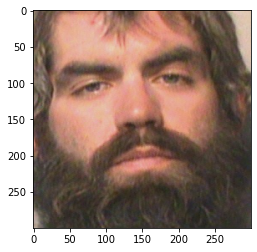

True BMI 24.998009107129327
Predicted BMI 1:  25.793747
Predicted BMI 2:  23.504263
Predicted BMI 3:  27.75017
Predicted BMI 4:  26.949545
Difference:  0.7957378411128602
*************************************************************************



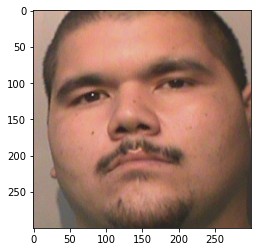

True BMI 39.74899161859423
Predicted BMI 1:  29.823969
Predicted BMI 2:  22.087267
Predicted BMI 3:  31.085155
Predicted BMI 4:  28.04948
Difference:  9.92502273126513
*************************************************************************



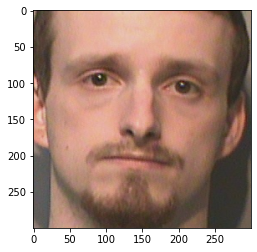

True BMI 22.17575321879467
Predicted BMI 1:  20.601007
Predicted BMI 2:  20.734049
Predicted BMI 3:  25.099543
Predicted BMI 4:  20.71056
Difference:  1.57474575724682
*************************************************************************



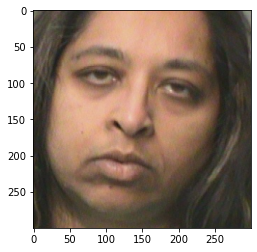

True BMI 32.92206584413169
Predicted BMI 1:  24.434381
Predicted BMI 2:  21.180065
Predicted BMI 3:  25.41379
Predicted BMI 4:  25.33433
Difference:  8.487684359146336
*************************************************************************



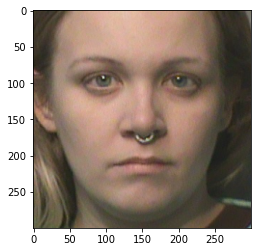

True BMI 29.85945044433706
Predicted BMI 1:  23.445398
Predicted BMI 2:  20.091433
Predicted BMI 3:  30.168535
Predicted BMI 4:  23.137056
Difference:  6.414052113648584
*************************************************************************



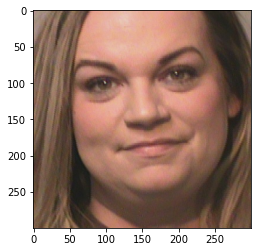

True BMI 27.36860318011293
Predicted BMI 1:  26.093258
Predicted BMI 2:  17.094692
Predicted BMI 3:  23.026031
Predicted BMI 4:  23.954632
Difference:  1.2753452760601967
*************************************************************************



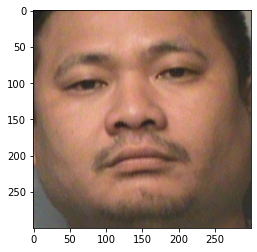

True BMI 29.18011011803274
Predicted BMI 1:  26.105555
Predicted BMI 2:  24.000957
Predicted BMI 3:  28.842934
Predicted BMI 4:  26.99589
Difference:  3.0745555373442635
*************************************************************************



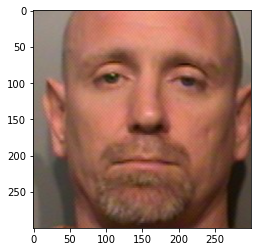

True BMI 29.414111481284188
Predicted BMI 1:  24.528927
Predicted BMI 2:  22.1917
Predicted BMI 3:  26.785252
Predicted BMI 4:  22.12518
Difference:  4.885184631918953
*************************************************************************



In [57]:
true_bmi=[]
predicted_bmi1=[]
predicted_bmi2=[]
predicted_bmi3=[]
predicted_bmi4=[]

for ii,path in enumerate(all_paths_val[:]):
    image_path='../data/face/'+str(path)
    img = cv2.imread(image_path)
    data = image.imread(image_path)
    new_image=preprocess_image(img,data,image_path=None)
    if isinstance(new_image,np.ndarray):
        new_image=np.expand_dims(new_image,axis=0)
        #plt.imshow(data)
        #plt.show()
        plt.imshow(new_image[0,:,:,:])
        plt.show()
        bmi_predict=loaded_model1.predict(new_image/255.0)
        bmi_predict2=loaded_model2.predict(new_image/255.0)
        bmi_predict3=loaded_model3.predict(new_image/255.0)
        bmi_predict4=loaded_model4.predict(new_image/255.0)


        print('True BMI', all_bmi_val.iloc[ii])
        print('Predicted BMI 1: ',bmi_predict[0][0])
        print('Predicted BMI 2: ',bmi_predict2[0][0])
        print('Predicted BMI 3: ',bmi_predict3[0][0])
        print('Predicted BMI 4: ',bmi_predict4[0][0])
        print('Difference: ',np.abs(all_bmi_val.iloc[ii]-bmi_predict[0][0]))
        print('*************************************************************************\n')
        true_bmi.append(all_bmi_val.iloc[ii])
        predicted_bmi1.append(bmi_predict[0][0])
        predicted_bmi2.append(bmi_predict2[0][0])
        predicted_bmi3.append(bmi_predict3[0][0])
        predicted_bmi4.append(bmi_predict4[0][0])



Text(0, 0.5, 'BMI')

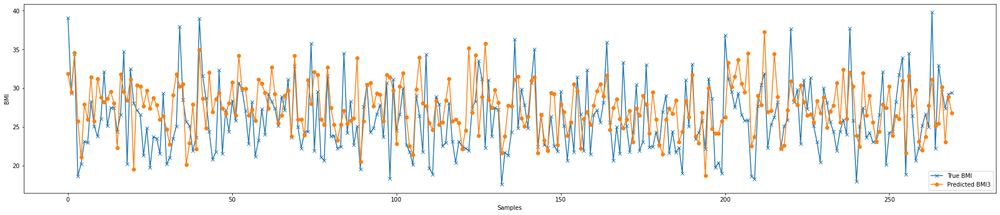

In [59]:
plt.figure(figsize=(30,6))
plt.plot(true_bmi,'x-',label='True BMI')
# plt.plot(predicted_bmi1,'o-',label='Predicted BMI1')
# plt.plot(predicted_bmi2,'o-',label='Predicted BMI2')
plt.plot(predicted_bmi3,'o-',label='Predicted BMI3')
#plt.plot(predicted_bmi4,'o-',label='Predicted BMI4')
plt.legend()
plt.xlabel('Samples')
plt.ylabel('BMI')

In [60]:
truenp=np.array(true_bmi)
predictnp=np.array(predicted_bmi3)

Text(0, 0.5, 'BMI')

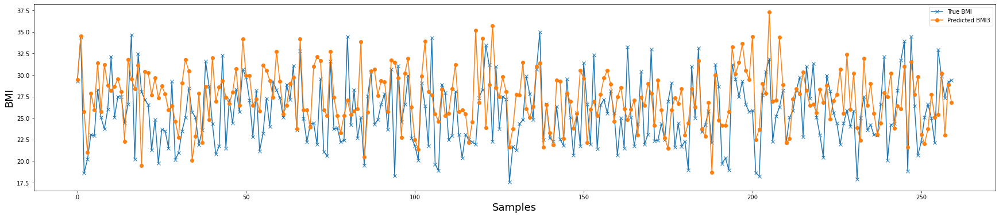

In [63]:
plt.figure(figsize=(30,6))
plt.plot(truenp[truenp<35],'x-',label='True BMI')
# plt.plot(predicted_bmi1,'o-',label='Predicted BMI1')
# plt.plot(predicted_bmi2,'o-',label='Predicted BMI2')
plt.plot(predictnp[truenp<35],'o-',label='Predicted BMI3')
#plt.plot(predicted_bmi4,'o-',label='Predicted BMI4')
plt.legend()
plt.xlabel('Samples', fontsize=18)
plt.ylabel('BMI', fontsize=18)

Text(0, 0.5, 'BMI')

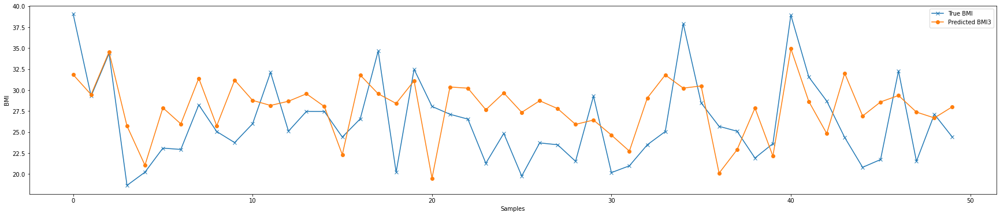

In [64]:
plt.figure(figsize=(30,6))
plt.plot(true_bmi[:50],'x-',label='True BMI')
# plt.plot(predicted_bmi1,'o-',label='Predicted BMI1')
# plt.plot(predicted_bmi2,'o-',label='Predicted BMI2')
plt.plot(predicted_bmi3[:50],'o-',label='Predicted BMI3')
#plt.plot(predicted_bmi4,'o-',label='Predicted BMI4')
plt.legend()
plt.xlabel('Samples')
plt.ylabel('BMI')

Text(0, 0.5, 'BMI')

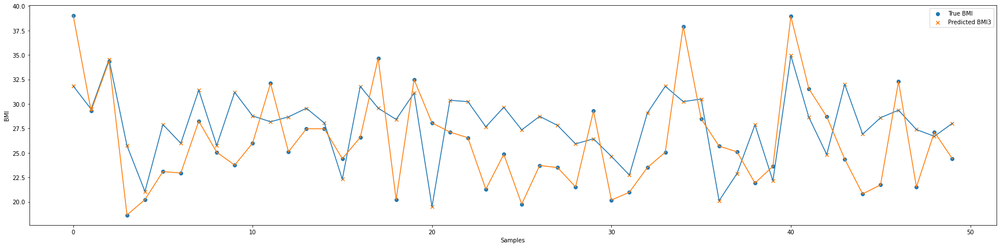

In [65]:
plt.figure(figsize=(30,7))
plt.scatter(np.arange(0,50,1),true_bmi[:50],label='True BMI')
# plt.plot(predicted_bmi1,'o-',label='Predicted BMI1')
# plt.plot(predicted_bmi2,'o-',label='Predicted BMI2')
plt.scatter(np.arange(0,50,1),predicted_bmi3[:50],label='Predicted BMI3',marker='x')
#plt.plot(predicted_bmi4,'o-',label='Predicted BMI4')
plt.plot(predicted_bmi3[:50])
plt.plot(true_bmi[:50])
plt.legend()
plt.xlabel('Samples')
plt.ylabel('BMI')

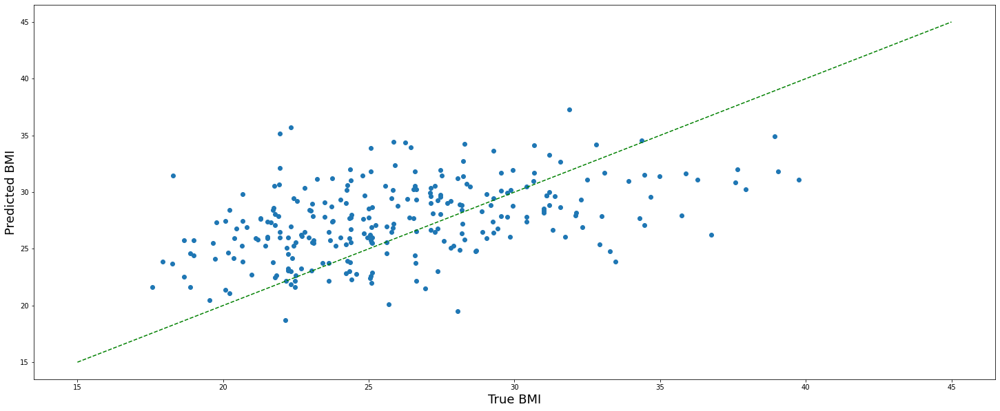

In [68]:
plt.figure(figsize=(25,10))
#plt.scatter(true_bmi,predicted_bmi3)
#plt.plot(true_bmi,predicted_bmi3, 'o')
plt.xlabel('True BMI', fontsize=18)
plt.ylabel('Predicted BMI', fontsize=18)


#create basic scatterplot
plt.plot(true_bmi,predicted_bmi3, 'o')

#obtain m (slope) and b(intercept) of linear regression line
#m, b = np.polyfit(true_bmi,predicted_bmi3, '1')

#add linear regression line to scatterplot 
#plt.plot(true_bmi, m*true_bmi+b)
plt.plot([15,45],[15,45],'g--')

In [15]:
## Mean Absolute Error Model 1
np.abs(np.array(true_bmi) - np.array(predicted_bmi1)).mean()

4.117149836828446

In [16]:
## Mean Absolute Error Model 2
np.abs(np.array(true_bmi) - np.array(predicted_bmi2)).mean()

4.460083911819131

In [17]:
## Mean Absolute Error Model 3
np.abs(np.array(true_bmi) - np.array(predicted_bmi3)).mean()

3.6107135545417526

In [18]:
## Mean Absolute Error Model 4
np.abs(np.array(true_bmi) - np.array(predicted_bmi4)).mean()

3.3563259035120114

### Histograms for BMI

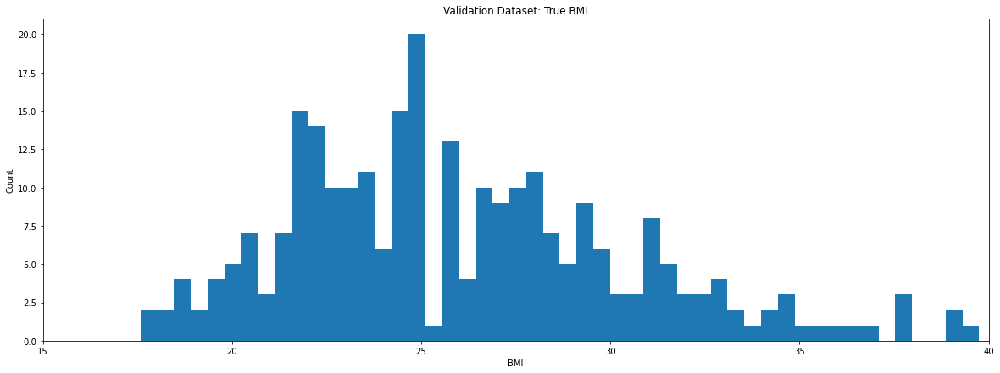

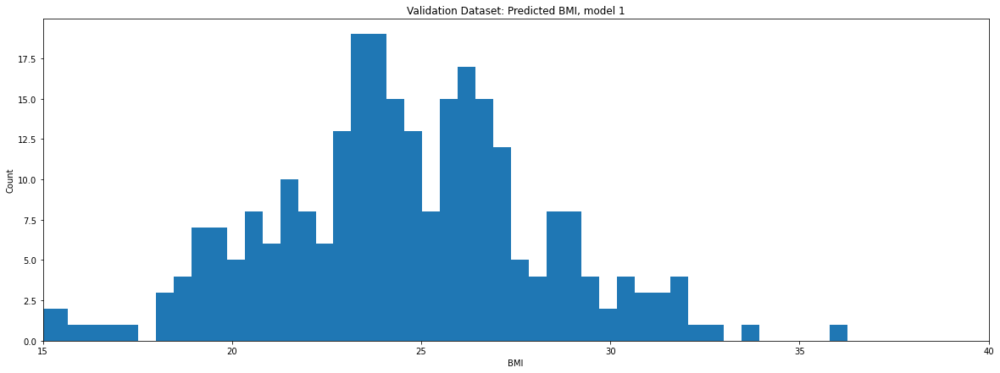

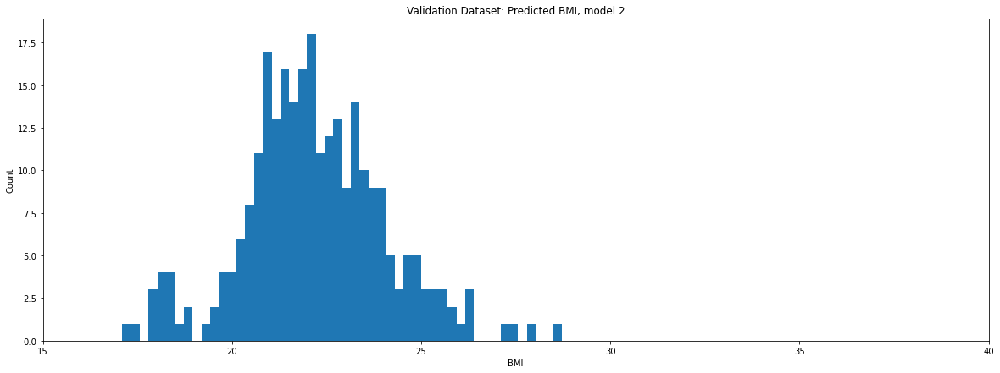

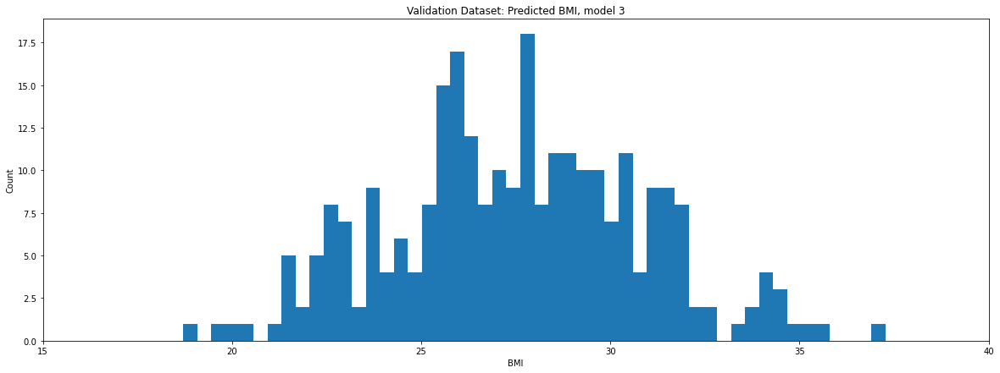

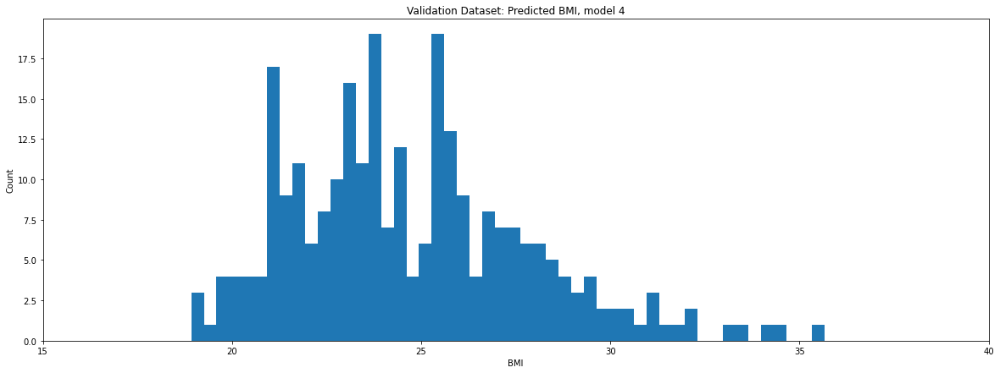

In [19]:
plt.figure(figsize=(20,7))
plt.hist(true_bmi,bins=50)
plt.xlim(15,40)
plt.xlabel('BMI')
plt.ylabel('Count')
plt.title('Validation Dataset: True BMI')
plt.show()


plt.figure(figsize=(20,7))
plt.hist(predicted_bmi1,bins=50)
plt.xlim(15,40)
plt.xlabel('BMI')
plt.ylabel('Count')
plt.title('Validation Dataset: Predicted BMI, model 1')
plt.show()


plt.figure(figsize=(20,7))
plt.hist(predicted_bmi2,bins=50)
plt.xlim(15,40)
plt.xlabel('BMI')
plt.ylabel('Count')
plt.title('Validation Dataset: Predicted BMI, model 2')
plt.show()

plt.figure(figsize=(20,7))
plt.hist(predicted_bmi3,bins=50)
plt.xlim(15,40)
plt.xlabel('BMI')
plt.ylabel('Count')
plt.title('Validation Dataset: Predicted BMI, model 3')
plt.show()


plt.figure(figsize=(20,7))
plt.hist(predicted_bmi4,bins=50)
plt.xlim(15,40)
plt.xlabel('BMI')
plt.ylabel('Count')
plt.title('Validation Dataset: Predicted BMI, model 4')
plt.show()